In [9]:

print('Started Python Code (inside)')
import os
import numpy as np
from numpy import savetxt
import pandas as pd
import glob

#import matplotlib
#matplotlib.use('Agg')  # Use the 'Agg' backend for non-GUI operations
import matplotlib.pyplot as plt

#from IPython.display import display, HTML

import tensorflow as tf
#from keras.utils.vis_utils import plot_model
#from keras.preprocessing.sequence import TimeseriesGenerator

from scipy.io import loadmat

import xgboost as xgb
import lightgbm as lgb
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import AdaBoostClassifier

from sklearn.model_selection import train_test_split #to split the dataset for training and testing
from sklearn.svm import SVC   #for Support Vector Machine (SVM) Algorithm

from sklearn import preprocessing
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier

from sklearn.neighbors import KNeighborsClassifier  # for K nearest neighbours
from sklearn.tree import DecisionTreeClassifier #for using Decision Tree Algoithm
import sklearn
from sklearn import preprocessing
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression 
from sklearn.neighbors import KNeighborsClassifier  # for K nearest neighbours
from sklearn.svm import SVC   #for Support Vector Machine (SVM) Algorithm
from sklearn.tree import DecisionTreeClassifier #for using Decision Tree Algoithm
from sklearn.model_selection import train_test_split #to split the dataset for training and testing

import mne
from mne.stats import permutation_cluster_test
from timeit import default_timer as timer 
from keras.models import Sequential
from keras.layers import Dense, Flatten, Dropout, Conv1D, Conv2D, Conv3D, MaxPooling1D, MaxPooling2D, MaxPooling3D
from tensorflow.keras.optimizers import Adam

from sklearn.preprocessing import StandardScaler

from confidenceinterval import roc_auc_score
import copy
#from tdqm import tdqm

from scipy.stats import ttest_ind, ttest_1samp
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from scipy.signal import convolve2d

import sys
#sys.path.append('C:/GitHub/ML_models/Whether_Project/')
#from custumBoost_matrix import CustomFeatureFabrique  

import pickle
import re


class ExperimentData:
    def __init__(self, epochs = [], groups = [], phase= [], stim= [], subj= [], triggers= []):
        self.data = epochs
        self.groups = groups
        self.phase = phase
        self.stimulus = stim
        self.subject_id = subj
        self.triggers = triggers
        self.labels = []
        self.include_patterns = []
        self.exclude_patterns = []
        self.num_splits = 4

    def load_and_concatenate_specific_pickles(self):
        all_epochs = []
        all_triggers = []
        all_labels = []
        all_phase = []
        all_stimuli = []
        all_subjects = []
        all_new_labels = []

        for root, dirs, files in os.walk(self.folder_path):
            for file in files:
                if file.endswith(".pkl") and all(pattern in file for pattern in self.include_patterns) and not any(pattern in file for pattern in self.exclude_patterns):
                    filepath = os.path.join(root, file)
                    print(f'Loading file {filepath}')
                    new_labels, epochs, triggers, labels, phase, stimuli, subjects = [],[],[],[],[],[],[]
                    with open(filepath, 'rb') as f:
                        epochs, triggers, labels, phase, stimuli, subjects = pickle.load(f)
                    epochs = epochs[:,:,:]
                
                    new_labels = np.array(np.empty(len(labels), dtype ='U16'))
                    if all(labels == True):
                        new_labels = 'Blinded' * len(labels)
                    elif all(labels == False):
                        new_labels = 'NotBlinded' * len(labels)

                    print(new_labels)
                    all_epochs.append(epochs)
                    all_triggers.extend(triggers)
                    all_labels.extend(labels)
                    all_new_labels.extend(new_labels)
                    all_phase.extend(phase)
                    all_stimuli.extend(stimuli)
                    all_subjects.extend(subjects)

        # Concatenate lists into numpy arrays
        self.data = np.concatenate(all_epochs, axis=2) #.transpose(2, 0, 1)  # Assuming epochs are of shape (n_channels, n_times, n_epochs)
        self.triggers = np.array(all_triggers)  # Shape: (total_epochs,)
        self.groups = np.array(all_labels)  # Shape: (total_epochs,)
        self.labels = np.array(new_labels)
        self.phase = np.array(all_phase)  # Shape: (total_epochs,)
        self.stimulus = np.array(all_stimuli)  # Shape: (total_epochs,)
        self.subject_id = np.array(all_subjects)  # Shape: (total_epochs,)
        self.experiment = ["IB"] * self.phase.shape[0]  # THIS WILL NEED TO BE MODIFIED ONCE ALL EXPs are added

        #self.split_data(self.num_splits)
        return self

    def filter_data(self, variable_name, values, include=True,mask=[]):
        # Get the variable to filter on
        variable = getattr(self, variable_name)

        # Convert to NumPy array for consistency
        variable = np.array(variable)
        
        # Create a boolean mask
        if np.empty(mask):
            if include:
                mask = np.isin(variable, values)
            else:
                mask = ~np.isin(variable, values)

        # Apply the mask to filter the data
        self.data = self.data[:, :, mask]
        self.groups = self.groups[mask]
        self.phase = np.array(self.phase)[mask]
        self.stimulus = np.array(self.stimulus)[mask]
        self.subject_id = np.array(self.subject_id)[mask]
        self.triggers = np.array(self.triggers)[mask]

    def normalize_subject_data(self):
        # Get the unique subjects
        unique_subjects = np.unique(self.subject_id)

        # Iterate over each subject
        for subj in unique_subjects:
            # Create a mask for the current subject
            subj_mask = self.subject_id == subj

            # Get the data for the current subject
            subj_data = self.data[:, :, subj_mask]

            # Compute the mean for the current subject's data
            subj_mean = np.mean(subj_data, axis=(0, 2), keepdims=True)

            # Subtract the mean from the current subject's data
            self.data[:, :, subj_mask] -= subj_mean
        
    def get_second_half_mask(self):
        # Get the unique subjects
        unique_subjects = np.unique(self.subject_id)

        # Initialize the mask with False
        mask = np.zeros(len(self.subject_id), dtype=bool)

        # Iterate over each subject
        for subj in unique_subjects:
            # Create a mask for the current subject
            subj_mask = self.subject_id == subj

            # Get the indices for this subject
            subj_indices = np.where(subj_mask)[0]

            # Calculate the midpoint
            midpoint = len(subj_indices) // 2

            # Set the second half to True in the mask
            mask[subj_indices[midpoint:]] = True
        
        self.data = self.data[:, :, mask]
        self.groups = self.groups[mask]
        self.phase = np.array(self.phase)[mask]
        self.stimulus = np.array(self.stimulus)[mask]
        self.subject_id = np.array(self.subject_id)[mask]
        self.triggers = np.array(self.triggers)[mask]

        return self

    def split_data(self, num_of_splits):

        # Get unique subjects
        unique_subjects = np.unique(self.subject_id  )

        # Generate random splits for the participants
        splits = np.random.randint(1, num_of_splits + 1, size=len(unique_subjects))

        # Create a dictionary to map each subject to their assigned split
        subject_to_split = {subject: split for subject, split in zip(unique_subjects, splits)}

        # Assign splits to each participant and create the 'test'/'train' arrays
        subject_indices = np.array([subject_to_split[subj] for subj in self.subject_id]) - 1

        split_matrix = np.ones((len(self.subject_id), num_of_splits))

        #split_matrix = np.tile([1], (len(self.subject_id), num_of_splits))
        split_matrix[np.arange(len(self.subject_id)), subject_indices] = 0

        #self.splits = split_matrix.tolist()
        self.splits = split_matrix
    
    def split_data_by_groups(self, num_of_splits):
        # Separate unique subjects into two groups
        unique_subjects = np.unique(self.subject_id)
        group_0 = [subj for subj in unique_subjects if self.groups[np.where(self.subject_id == subj)[0][0]] == 0]
        group_1 = [subj for subj in unique_subjects if self.groups[np.where(self.subject_id == subj)[0][0]] == 1]

        print(group_0)
        
        # Shuffle the subjects within each group
        np.random.shuffle(group_0)
        np.random.shuffle(group_1)
        
        # Determine the number of subjects in each split for each group
        num_per_split_0 = len(group_0) // num_of_splits
        num_per_split_1 = len(group_1) // num_of_splits
        
        # Initialize splits for each group
        splits_0 = [group_0[i * num_per_split_0:(i + 1) * num_per_split_0] for i in range(num_of_splits)]
        splits_1 = [group_1[i * num_per_split_1:(i + 1) * num_per_split_1] for i in range(num_of_splits)]
        
        # Adjust for any remaining subjects
        remainder_0 = group_0[num_per_split_0 * num_of_splits:]
        remainder_1 = group_1[num_per_split_1 * num_of_splits:]
        
        for i, subj in enumerate(remainder_0):
            splits_0[i % num_of_splits].append(subj)
        
        for i, subj in enumerate(remainder_1):
            splits_1[i % num_of_splits].append(subj)
        
        # Combine the splits from both groups
        splits = [split_0 + split_1 for split_0, split_1 in zip(splits_0, splits_1)]
        
        # Create a dictionary to map each subject to their assigned split
        subject_to_split = {subj: i + 1 for i, split in enumerate(splits) for subj in split}
        
        # Assign splits to each participant and create the 'test'/'train' arrays
        subject_indices = np.array([subject_to_split[subj] for subj in self.subject_id]) - 1
        
        split_matrix = np.ones((len(self.subject_id), num_of_splits))
        split_matrix[np.arange(len(self.subject_id)), subject_indices] = 0
        
        self.splits = split_matrix
        
    def get_filtered_data(self):
        return self.data, self.groups, self.phase, self.stimulus, self.subject_id, self.triggers

    def create_split_masks(self, variable_name, n_splits=5, stratified=True):
        variable = getattr(self, variable_name)

        if stratified:
            skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
            splits = skf.split(np.zeros(len(variable)), variable)
        else:
            kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
            splits = kf.split(variable)

        self.splits = list(splits)

    def get_split_data2(self, split_index):
        if self.splits is None:
            raise ValueError("Splits not created. Please run create_split_masks first.")

        splits_array = self.splits[:,split_index]
        print(splits_array)
        train_index = splits_array == 1
        
        test_index = splits_array == 0

        train_data = {
            'epochs': self.data[:, :, train_index],
            'groups': self.groups[train_index],
            'phase': np.array(self.phase)[train_index],
            'stim': np.array(self.stimulus)[train_index],
            'subj': np.array(self.subject_id)[train_index],
            'triggers': np.array(self.triggers)[train_index]
        }
        test_data = {
            'epochs': self.data[:, :, test_index],
            'groups': self.groups[test_index],
            'phase': np.array(self.phase)[test_index],
            'stim': np.array(self.stimulus)[test_index],
            'subj': np.array(self.subject_id)[test_index],
            'triggers': np.array(self.triggers)[test_index]
        }

        return train_data, test_data

    def get_split_data(self, split_index):
        if self.splits is None:
            raise ValueError("Splits not created. Please run create_split_masks first.")

        train_index, test_index = self.splits[split_index]

        train_data = {
            'epochs': self.data[:, :, train_index],
            'groups': self.groups[train_index],
            'phase': np.array(self.phase)[train_index],
            'stim': np.array(self.stimulus)[train_index],
            'subj': np.array(self.subject_id)[train_index],
            'triggers': np.array(self.triggers)[train_index]
        }
        test_data = {
            'epochs': self.data[:, :, test_index],
            'groups': self.groups[test_index],
            'phase': np.array(self.phase)[test_index],
            'stim': np.array(self.stimulus)[test_index],
            'subj': np.array(self.subject_id)[test_index],
            'triggers': np.array(self.triggers)[test_index]
        }

        return train_data, test_data
    
    def compute_average_erps(self):
        unique_subjects = np.unique(self.subject_id)
        unique_triggers = np.unique(self.triggers)
        
        for subj in unique_subjects:
            subj_erps = []
            for trigger in unique_triggers:
                subj_trigger_epochs = self.data[:, :, (self.subject_id == subj) & (self.triggers == trigger)]
                avg_erp = np.mean(subj_trigger_epochs, axis=2)
                subj_erps.append(avg_erp)
            self.average_erps[subj] = subj_erps

    def get_average_erp(self, subj, trigger):
        subj_erps = self.average_erps.get(subj, None)
        if subj_erps is not None:
            return subj_erps[trigger]
        else:
            return None

    def cluster_test(self, channel, trigger_set1, trigger_set2):
            mask1 = np.isin(self.triggers, trigger_set1)
            print(mask1)
            mask2 = np.isin(self.triggers, trigger_set2)
            print(mask2)

            data1 = self.data[:, :, mask1]
            data2 = self.data[:, :, mask2]

            #data1 = np.expand_dims(data1,0)
            #data2 = np.expand_dims(data2,0)

            print(data1.shape)

            data = [data1.transpose(2, 0, 1), data2.transpose(2, 0, 1)]

            # Run the cluster-based permutation test
            T_obs, clusters, cluster_p_values, H0 = spatio_temporal_cluster_test(
                data, n_permutations=1000, tail=0, n_jobs=-1, threshold=None, 
                out_type='mask'
            )

                # Store cluster information
            self.T_obs = T_obs
            self.clusters = clusters
            self.cluster_p_values = cluster_p_values
            self.H0 = H0

            # Plot the results
            plt.figure(figsize=(10, 6))
            times = np.arange(data1.shape[0])
            for i_c, c in enumerate(clusters):
                c = c[0]
                if cluster_p_values[i_c] <= 0.05:
                    h = plt.axvspan(times[c.start], times[c.stop - 1], color='r', alpha=0.3)
            plt.plot(times, data1.mean(axis=1) - data2.mean(axis=1), label='Difference')
            plt.legend()
            plt.title(f'Cluster-based permutation test results for channel {channel}')
            plt.xlabel('Time (samples)')
            plt.ylabel('ERP Difference')
            plt.show()

# # Example usage
# epochs = np.random.rand(64, 1000, 10)  # Example epochs data
# labels = np.array(['label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1'])
# phase = np.array(['phase1', 'phase2', 'phase3', 'phase1', 'phase2', 'phase3', 'phase1', 'phase2', 'phase3', 'phase1'])
# stim = np.array(['face', 'house', 'noise', 'face', 'house', 'noise', 'face', 'house', 'noise', 'face'])
# subj = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])
# triggers = np.array([1, 2, 3, 1, 2, 3, 1, 2, 3, 1])


# filtered_epochs, filtered_labels, filtered_phase, filtered_stim, filtered_subj, filtered_triggers = data_filter.get_filtered_data()

# print(filtered_epochs.shape, filtered_labels, filtered_phase, filtered_stim, filtered_subj, filtered_triggers)

import numpy as np

def filter_data(epochs, labels, phase, stim, subj, triggers, interested_triggers):
    labels = lbl_clf.fit_transform(labels)
    
    # Convert triggers and interested_triggers to NumPy arrays
    triggers = np.array(triggers)
    interested_triggers = np.array(interested_triggers)
    
    # Create a boolean mask for interested triggers
    mask = np.isin(triggers, interested_triggers)
    
    # Apply the mask to filter the data
    filtered_epochs = epochs[:, :, mask]
    filtered_labels = labels[mask]
    filtered_triggers = triggers[mask]
    
    return filtered_epochs, filtered_triggers, filtered_labels, filtered_stim, filtered_subj, filtered_phase

# Example usage
# epochs = np.random.rand(64, 1000, 10)  # Example epochs data
# labels = np.array(['label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1'])
# triggers = np.array([1, 2, 3, 1, 2, 3, 1, 2, 3, 1])
# interested_triggers = [1, 3]

# filtered_epochs, filtered_triggers, filtered_labels = filter_data(epochs, labels, triggers, interested_triggers)
# print(filtered_epochs.shape, filtered_triggers, filtered_labels)


import pandas as pd
import numpy as np

def transform_data_3D(data_all, headmodel):
    #print('Creating and reshaping data into headmodel 2D')
    # Load the headmodel CSV file containing XYZ EEG map locations
    map = pd.read_csv(headmodel, skiprows=0, header=None)
    map = np.array(map)

    N = len(map)

    # Define the dimensions of the rectangular grid
    grid_width = 9
    grid_height = 9

    # Load electrode information (assuming it's in a N x 4 NumPy array)
    electrode_info = map

    # Determine the minimum and maximum x and y coordinates from the original data
    min_x = np.min(electrode_info[:, 1])
    max_x = np.max(electrode_info[:, 1])
    min_y = np.min(electrode_info[:, 2])
    max_y = np.max(electrode_info[:, 2])

    # Calculate scaling factors to map original coordinates to the larger grid
    x_scale = (max_x - min_x) / (grid_width - 1)
    y_scale = (max_y - min_y) / (grid_height - 1)

    # Initialize the 7x9 grid
    grid_large = np.zeros((grid_height, grid_width), dtype=int)

    # Track the next available position
    available_positions = [(i, j) for i in range(grid_height) for j in range(grid_width)]
    
    # Populate the grid with electrode numbers based on rescaled positions
    for electrode in electrode_info:
        x = (electrode[1] - min_x) / x_scale  # Rescale x-coordinate
        y = (electrode[2] - min_y) / y_scale  # Rescale y-coordinate
        row = int(round(y))  # Round to the nearest row index
        col = int(round(x))  # Round to the nearest column index
        
        if grid_large[row, col] != 0:  # If position is already occupied, find next available
            for pos in available_positions:
                if grid_large[pos[0], pos[1]] == 0:
                    row, col = pos
                    break
        
        grid_large[row, col] = electrode[0]  # Use the electrode number
        available_positions.remove((row, col))

    # Now, 'grid_large' contains the electrode numbers arranged in a 7x9 grid based on the rescaled positions

    #print(grid_large)

    # Assuming data_all is a 3D array containing multiple files (num_files, num_electrodes, num_samples)
    # Make sure data_all has the correct shape and data

   # Initialize an empty array to accumulate reshaped data across all files
    reshaped_data_accumulated = np.zeros((data_all.shape[0], grid_height, grid_width, data_all.shape[2]))

    for count, original_data in enumerate(data_all):

        # Initialize the reshaped_data for the current file
        reshaped_data = np.zeros((grid_height, grid_width, original_data.shape[1]))

        for row in range(grid_height):
            for col in range(grid_width):
                electrode_num = grid_large[row, col]
                if electrode_num != 0:
                    reshaped_data[row, col, :] = original_data[electrode_num - 1, :]

        # Accumulate reshaped data for the current file
        reshaped_data_accumulated[count] = reshaped_data


    # reshaped_data_accumulated now contains reshaped data from all files

    selected_data = reshaped_data_accumulated
    return selected_data

import numpy as np

def average_trials(data, labels, average_trials=10):

    if average_trials < 2:
        averaged_data = data
        averaged_labels = labels
    else:

        averaged_data = []
        averaged_labels = []

        # Separate data based on labels
        #unique_labels = np.unique(labels)
        
        unique_labels, counts = np.unique(labels, return_counts=True)
        max_trials = counts.max()
        #max_trials = 10000
        #len(label)

        for label in unique_labels:
            
            label_data = data[labels == label]
            #num_trials = label_data.shape[0]
            num_trials = max_trials
            
            # Calculate number of batches needed to sample with substitution
            num_batches = int(np.ceil(len(label_data) / average_trials))

            # Loop over the data and collect averages with substitution
            for _ in range(num_trials):
                # Sample with replacement
                indices = np.random.choice(len(label_data), average_trials, replace=True)
                batch_data = label_data[indices]
                
                # Compute average and append to list
                averaged_trial = np.mean(batch_data, axis=0)
                averaged_data.append(averaged_trial)
                averaged_labels.append(label)
    print('Averaged data shape:', np.array(averaged_data).shape)
    return np.array(averaged_data), np.array(averaged_labels)

def balance_trials(data, labels, average_trials=5):
    if average_trials < 2:
        return data, labels

    unique_labels, counts = np.unique(labels, return_counts=True)
    max_trials = counts.max()

    balanced_data = []
    balanced_labels = []

    for label in unique_labels:
        label_data = data[labels == label]
        num_trials = label_data.shape[0]
        
        if num_trials < max_trials:
            # Calculate number of batches needed to sample with substitution
            num_batches = int(np.ceil(max_trials / num_trials))
            for _ in range(num_batches):
                indices = np.random.choice(len(label_data), average_trials, replace=True)
                batch_data = label_data[indices]
                averaged_trial = np.mean(batch_data, axis=0)
                balanced_data.append(averaged_trial)
                balanced_labels.append(label)
        else:
            for _ in range(max_trials):
                indices = np.random.choice(len(label_data), average_trials, replace=True)
                batch_data = label_data[indices]
                averaged_trial = np.mean(batch_data, axis=0)
                balanced_data.append(averaged_trial)
                balanced_labels.append(label)

    return np.array(balanced_data), np.array(balanced_labels)


def shuffle_data(dataset,labels):
    # Create an index array to shuffle the data and labels in the same order
    index = np.arange(len(labels))
    index = np.random.shuffle(index)

    # Shuffle the dataset and labels using the index array
    shuffled_dataset = dataset[index,...]
    shuffled_labels = labels[index]
    return shuffled_dataset, shuffled_labels
    # Now, shuffled_dataset and shuffled_labels contain the data and labels shuffled in the same order


import numpy as np
import mne
#mne.parallel(verbose=0)
from mne.time_frequency import tfr_array_morlet

def make_time_frequency_avg(data,freq):
    print('Computing Time-Frequency')
    # Step 1: Create MNE Raw object
    # Example parameters, you should replace these with your actual data parameters
    sfreq = 500  # Sampling frequency
    ch_names = [str(i) for i in range(1, 65)]
    info = mne.create_info(ch_names, sfreq, ch_types='eeg')

    # Step 2: Load your data into the Raw object
    # Example data array, replace it with your actual data array
    #data = np.random.randn(len(ch_names), 1000)  # Random data for demonstration
    #raw = mne.io.RawArray(data, info)

    # Step 3: Apply Wavelet Time-Frequency Analysis
    # Define frequency parameters
    fmin = freq[0]  # Minimum frequency
    fmax = freq[1]  # Maximum frequency
    frequencies = np.arange(fmin, fmax, 2)  # Frequency range
    n_cycles = frequencies / 2.  # Define number of cycles for each frequency

    # Perform time-frequency analysis using multitaper method with wavelets
    tfr = tfr_array_morlet(data, sfreq=sfreq, freqs=frequencies, n_cycles=n_cycles, verbose=False, n_jobs=-1)
    tfr = np.abs(tfr)**2

    # Calculate the average power in the alpha band
    avg_power_data = np.mean(tfr, axis=2)  # Average across the frequency axis
    #tfr, itc = tfr_multitaper(raw, freqs=frequencies, n_cycles=2, return_itc=True)
    #tfr.plot()
    #mne.viz.plot_tfr_array_morlet(tfr, info=info, freqs=freqs)
    # Visualize the time-frequency representation
    return avg_power_data#, itc

def make_time_frequency(data,freq):
    print('Computing Time-Frequency')
    # Step 1: Create MNE Raw object
    # Example parameters, you should replace these with your actual data parameters
    sfreq = 500  # Sampling frequency
    ch_names = [str(i) for i in range(1, 65)]
    info = mne.create_info(ch_names, sfreq, ch_types='eeg')

    # Step 2: Load your data into the Raw object
    # Example data array, replace it with your actual data array
    #data = np.random.randn(len(ch_names), 1000)  # Random data for demonstration
    #raw = mne.io.RawArray(data, info)

    # Step 3: Apply Wavelet Time-Frequency Analysis
    # Define frequency parameters
    fmin = freq[0]  # Minimum frequency
    fmax = freq[1]  # Maximum frequency
    frequencies = np.arange(fmin, fmax, 2)  # Frequency range
    n_cycles = frequencies / 2.  # Define number of cycles for each frequency

    # Perform time-frequency analysis using multitaper method with wavelets
    tfr = tfr_array_morlet(data, sfreq=sfreq, freqs=frequencies, n_cycles=n_cycles, verbose=False, n_jobs=-1)
    # Compute the power
    tfr_power = np.abs(tfr)**2

    # Convert to decibel (dB) scale
    tfr_db = 10 * np.log10(tfr_power)

    # Calculate the average power in the alpha band
    #avg_power_data = np.mean(tfr, axis=2)  # Average across the frequency axis
    #tfr, itc = tfr_multitaper(raw, freqs=frequencies, n_cycles=2, return_itc=True)
    #tfr.plot()
    #mne.viz.plot_tfr_array_morlet(tfr, info=info, freqs=freqs)
    # Visualize the time-frequency representation
    return tfr_db#, itc

    import tensorflow as tf
from tensorflow.keras import layers, Model, Input

def create_branch(input_tensor, name, conv_params):
    x = input_tensor
    for i, params in enumerate(conv_params):
        x = layers.Conv3D(filters=params['filters'], 
                          kernel_size=params['kernel_size'], 
                          strides=params['strides'], 
                          padding='same', 
                          activation='relu', 
                          name=f'{name}_conv3d_{i+1}')(x)
        x = layers.BatchNormalization(name=f'{name}_bn_{i+1}')(x)
        x = layers.Dropout(0.5)(x)
    
    x = layers.GlobalAveragePooling3D()(x)
    
    for i in range(3):  # 3 Dense layers as per the diagram
        x = layers.Dense(64, activation='relu', name=f'{name}_dense_{i+1}')(x)
        x = layers.BatchNormalization(name=f'{name}_dense_bn_{i+1}')(x)
    
    return x

def create_multi_branch_cnn(input_shape, num_classes):
    input_layer = Input(shape=input_shape, name='EEG_input')
    
    # SRF branch
    srf_params = [
        {'filters': 32, 'kernel_size': (2, 2, 1), 'strides': (2, 2, 1)},
        {'filters': 64, 'kernel_size': (2, 2, 1), 'strides': (2, 2, 1)}
    ]
    srf_branch = create_branch(input_layer, 'SRF', srf_params)
    
    # MRF branch
    mrf_params = [
        {'filters': 32, 'kernel_size': (3, 3, 5), 'strides': (2, 2, 4)},
        {'filters': 64, 'kernel_size': (2, 2, 3), 'strides': (2, 2, 2)}
    ]
    mrf_branch = create_branch(input_layer, 'MRF', mrf_params)
    
    # LRF branch
    lrf_params = [
        {'filters': 32, 'kernel_size': (2, 2, 7), 'strides': (2, 2, 4)},
        {'filters': 64, 'kernel_size': (2, 2, 5), 'strides': (2, 2, 4)}
    ]
    lrf_branch = create_branch(input_layer, 'LRF', lrf_params)
    
    # Concatenate branches
    merged = layers.Concatenate(name='merge_branches')([srf_branch, mrf_branch, lrf_branch])
    
    # Final dense layer
    output = layers.Dense(num_classes, activation='sigmoid', name='output')(merged)
    
    model = Model(inputs=input_layer, outputs=output, name='Multi_Branch_CNN')
    return model

#keras.backend.clear_session()
# Example usage
#input_shape = (X_train.shape[1:])  # Adjust based on your EEG data shape
#num_classes = 2  # Adjust based on the number of MI classes

#model = create_multi_branch_cnn(input_shape, num_classes)
#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
#model.summary()

#changes in strides and kernel sizes
def create_multi_branch_cnn2(input_shape, num_classes):
    
    input_layer = Input(shape=input_shape, name='EEG_input')
    scaled_input = layers.Rescaling(1/150, name='rescale')(input_layer)
    
    # SRF branch
    srf_params = [
        {'filters': 32, 'kernel_size': (2, 2, 1), 'strides': (2, 2, 1)},
        {'filters': 64, 'kernel_size': (2, 2, 1), 'strides': (2, 2, 1)}
    ]
    srf_branch = create_branch(scaled_input, 'SRF', srf_params)
    
    # MRF branch
    mrf_params = [
        {'filters': 32, 'kernel_size': (3, 3, 5), 'strides': (2, 2, 4)},
        {'filters': 64, 'kernel_size': (3, 3, 5), 'strides': (2, 2, 4)}
    ]
    mrf_branch = create_branch(scaled_input, 'MRF', mrf_params)
    
    # LRF branch
    lrf_params = [
        {'filters': 32, 'kernel_size': (5, 5, 10), 'strides': (3, 3, 5)},
        {'filters': 64, 'kernel_size': (3, 3, 5), 'strides': (3, 3, 5)}
    ]
    lrf_branch = create_branch(scaled_input, 'LRF', lrf_params)
    
    # Concatenate branches
    #merged = layers.Concatenate(name='merge_branches')([srf_branch])
    #merged = layers.Concatenate(name='merge_branches')([mrf_branch])
    #merged = layers.Concatenate(name='merge_branches')([lrf_branch])
    merged = layers.Concatenate(name='merge_branches')([srf_branch, mrf_branch, lrf_branch])
    
    # Final dense layer
    output = layers.Dense(num_classes, activation='sigmoid', name='output')(merged)
    
    model = Model(inputs=input_layer, outputs=output, name='Multi_Branch_CNN')
    return model

#keras.backend.clear_session()
# Example usage
#input_shape = (X_train.shape[1:])  # Adjust based on your EEG data shape
#num_classes = 2  # Adjust based on the number of MI classes

#model = create_multi_branch_cnn2(input_shape, num_classes)
#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
#model.summary()

import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import spectrogram

def plot_erp_tf_fft(data, masks, sfreq):
    # Compute ERP
    
    erp = np.mean(data, axis=0)

    # Compute TF representation
    #f, t, tf = spectrogram(data[masks], fs=sfreq)
    #print(tf.shape) # FOR SOME REASON HAS SHAPE 4d with 2 being last
    
    # Compute FFT
    freqs = np.arange(2, 30, 2)  # Define frequency range
    n_cycles = freqs / 2.  # Define number of cycles for each frequency
    tfr = mne.time_frequency.tfr_array_morlet(data, sfreq=sfreq, freqs=freqs, n_cycles=n_cycles)
    print(tfr.shape)
    avg_tf = np.mean(np.mean(np.abs(tfr),axis=1), axis=0)
    fft_data = np.fft.fft(data[masks])

    # Plot ERP
    plt.figure(figsize=(10, 5))
    plt.subplot(3, 1, 1)
    plt.plot(erp.T)
    plt.title('Average ERP')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')

    # Plot TF representation
    plt.subplot(3, 1, 2) 
    #plt.pcolormesh(t, f, np.log(np.mean(tf,axis=2)))
    plt.pcolormesh(avg_tf)
    plt.title('Time-Frequency Representation')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.colorbar()

    # Plot FFT
    plt.subplot(3, 1, 3)
    plt.plot(np.mean(np.abs(fft_data),axis = 0))
    plt.title('Fast Fourier Transform')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')

    plt.tight_layout()
    plt.show()

# def plot_erp_tf_fft(data, masks, sfreq):
#     # Compute ERP
    
#     erp = np.mean(data[masks], axis=0)

#     # Compute TF representation
#     #f, t, tf = spectrogram(data[masks], fs=sfreq)
#     #print(tf.shape) # FOR SOME REASON HAS SHAPE 4d with 2 being last
    
#     # Compute FFT
#     freqs = np.arange(2, 30, 2)  # Define frequency range
#     n_cycles = freqs / 2.  # Define number of cycles for each frequency
#     tfr = mne.time_frequency.tfr_array_morlet(data[masks], sfreq=sfreq, freqs=freqs, n_cycles=n_cycles)
#     print(tfr.shape)
#     avg_tf = np.mean(np.mean(np.abs(tfr),axis=1), axis=0)
#     fft_data = np.fft.fft(data[masks])

#     # Plot ERP
#     plt.figure(figsize=(10, 5))
#     plt.subplot(3, 1, 1)
#     plt.plot(erp.T)
#     plt.title('Average ERP')
#     plt.xlabel('Time')
#     plt.ylabel('Amplitude')

#     # Plot TF representation
#     plt.subplot(3, 1, 2) 
#     #plt.pcolormesh(t, f, np.log(np.mean(tf,axis=2)))
#     plt.pcolormesh(avg_tf)
#     plt.title('Time-Frequency Representation')
#     plt.xlabel('Time (s)')
#     plt.ylabel('Frequency (Hz)')
#     plt.colorbar()

#     # Plot FFT
#     plt.subplot(3, 1, 3)
#     plt.plot(np.mean(np.abs(fft_data),axis = 0))
#     plt.title('Fast Fourier Transform')
#     plt.xlabel('Frequency (Hz)')
#     plt.ylabel('Amplitude')

#     plt.tight_layout()
#     plt.show()

# Example usage
# Assuming data is your data cube (trials x channels x time)
# Assuming masks is your array of boolean masks
# Assuming sfreq is the sampling frequency of your data

# this_mask = (f_mask+h_mask)*(IB_mask)
# plot_erp_tf_fft(all_data, this_mask, 500)


lbl_clf = preprocessing.LabelEncoder() #function 

def preprocess_ML_data(data,variable_name):
    X = data['epochs']

    X = X.transpose(2,0,1)
    #X = X[:,:,500:1000]

    #headmodel = "E:\\TRI\\Reed_HM_58.csv"
    #X = transform_data_3D(X, headmodel)
    X = X.reshape(X.shape[0],-1)
    #X = np.expand_dims(X,4)

    y = data[variable_name]
    #print(y.shape)
        
    #y = np.reshape(np.array(y),-1)
    #y = lbl_clf.fit_transform(y)
    #y = tf.keras.utils.to_categorical(y=
    X,y = shuffle_data(X,y)
    #print(X.shape)
    X,y = average_trials(X, y)
    #print(X.shape)
    
    return X, y


lbl_clf = preprocessing.LabelEncoder() #function 

def preprocess_cnn_data(data,variable_name):
    X = data['epochs']

    X = X.transpose(2,0,1)
    #X = X[:,1:58,500:1000]

    headmodel = "E:\\TRI\\Reed_HM_58.csv"
    #X = make_time_frequency(X,[2,12])
    #X1 = make_time_frequency(X,[2,8])
    #X2 = make_time_frequency(X,[4,8])
    #X3 = make_time_frequency(X,[8,12])
    #X4 = make_time_frequency(X,[12,30])
    #X = cat(X,X2)
    X = transform_data_3D(X, headmodel)
    X = np.expand_dims(X,4)

    y = data[variable_name]
        
    y = np.array(y)

    X,y = shuffle_data(X,y)
    X,y = average_trials(X, y)

    #balance_trials(X, y, average_trials=5)

    y = lbl_clf.fit_transform(y)
    y = tf.keras.utils.to_categorical(y)

    return X, y


def print_sub_predictions(model,test_data):

    unique_subjs = np.unique(test_data['subj'].tolist())
    for subj in unique_subjs:

        subj_data_dict = {}

        # Loop through the keys in test_data to filter data for the specific subject
        for key in test_data.keys():
            subj_indices = test_data['subj'] == subj
            if key == 'epochs':  # If it's the epochs, need to be 3D
            # Filter data from current key that corresponds to the specified subject
            
                subj_data = test_data[key][:,:,subj_indices]
            else:
                subj_data = test_data[key][subj_indices]
            subj_dic = {key: subj_data}
            subj_data_dict = subj_data_dict | subj_dic

        X_test_subj, y_test_subj = preprocess_cnn_data(subj_data_dict, 'groups')

        # Print or store results to identify outliers
        predictions = model.predict(X_test_subj)

        # Calculate average prediction
        avg_prediction = np.mean(predictions)

        # Get real values
        real_value = np.array(subj_data_dict['groups'][0])

        # Print results
        print(f"Subject {subj} Avg. prediction: {avg_prediction:.4f} for {real_value:.0f}")
        # If you want to compare predictions to real values for each subject
        #for i, (pred) in enumerate(zip(predictions)):
            #subject_id = i + 1
            #print(f"Participant {subject_id}: Prediction = {pred[0]:.4f}, Real Value = {real_value}")

# TESTING ML 


Started Python Code (inside)


In [10]:
def print_ERP(erp, title):
    plt.figure(figsize=(10, 5))
    plt.subplot(3, 1, 1)
    plt.plot(erp)
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()

In [11]:
for root, dirs, files in os.walk(os.getcwd()):
    for file in files:
        if file.endswith(".pkl") and 'IB_eeg_data' in file:
            print(file)

IB_eeg_data_BLINDED_phase1.pkl
IB_eeg_data_NOTBLINDED_phase1.pkl
IB_eeg_data_BLINDED_phase2.pkl
IB_eeg_data_NOTBLINDED_phase2.pkl
IB_eeg_data_NOTBLINDED_phase3.pkl
IB_eeg_data_BLINDED_phase3.pkl
IB_eeg_data_DISK_BLINDED.pkl
IB_eeg_data_ERN_BLINDED.pkl


In [12]:
import mne
from mne.viz import plot_topomap
from mne.stats import spatio_temporal_cluster_test

In [13]:
def average_reference(data):
    # Assuming [trials, channels, time]
    mean_reference = np.mean(data, axis=0)
    data_avg_ref = data - mean_reference
    return data_avg_ref

def remove_baseline(data, time1, time2):
    # Assuming [trials, channels, time]
    
    new_data = data[:,time1:time2,:]
    mean_baseline = np.mean(new_data, axis=1, keepdims=True)
    #print(mean_baseline.shape)
    new_data2 = data - mean_baseline
    return new_data2

In [14]:
# Create MNE info
sfreq = 500  # Sampling frequency
montage = mne.channels.read_custom_montage('Reed_HM_59.loc')
n_channels = len(montage.ch_names)
ch_names = montage.ch_names
ch_types = ['eeg'] * n_channels
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)
info.set_montage(montage)

Measurement date,Unknown
Experimenter,Unknown
Participant,Unknown
Digitized points,62 points
Good channels,59 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,500.00 Hz
Highpass,0.00 Hz
Lowpass,250.00 Hz


In [15]:
# Create a mask for only 59 channels

chan_mask = np.full(64,True)
chan_mask[58] = False
chan_mask[60:64] = False


In [16]:
from keras import regularizers
from keras.layers import GaussianNoise

import copy
import datetime

num_of_splits = 4
all_data = ExperimentData([],[],[],[],[],[])
all_data.folder_path = os.getcwd()
all_data.include_patterns = ['IB_eeg_data_BLINDED']
all_data.exclude_patterns = ['phase3','NOTBLINDED','ERN','DISK']
all_data.num_splits = 4
all_data.load_and_concatenate_specific_pickles()
#all_data.filter_data('subject_id', [1,48,51,72,91,93], include=False)

all_data.filter_data('groups', [0], include=False)
#all_data = ExperimentData(epochs, groups, phase, stim, subj, triggers)

# Filter Data
all_data.labels = np.array(np.empty(len(all_data.groups), dtype ='U16'))

all_data.labels[all_data.groups == 1] = "Blinded"
all_data.labels[all_data.groups == 0] = "NotBlinded"

Loading file d:\ML_models\IB_paper\IB_eeg_data_BLINDED_phase1.pkl
['' '' '' ... '' '' '']
Loading file d:\ML_models\IB_paper\IB_eeg_data_BLINDED_phase2.pkl
['' '' '' ... '' '' '']


KeyboardInterrupt: 

In [61]:


stim = ['face','house','noise']

time_freq = True

for k, stim in enumerate(stim):
    diff = []
    for j, label in enumerate(np.unique(all_data.phase)):
        full_erp = []
        erps = []
        for i in np.unique(all_data.subject_id):
            print('Running participant',i)
            
            vis_mask = all_data.phase == label
            stim_mask = all_data.stimulus == stim
            groups_mask = all_data.groups == 1
            subject_mask = all_data.subject_id == i
            final_mask = subject_mask * stim_mask * vis_mask * groups_mask
        
            this_data = all_data.data[:,:,final_mask]
            this_data = this_data[chan_mask,:,:]

            #noise_mask = all_data.stimulus == 'noise'
            
            final_noise_mask = subject_mask * noise_mask * vis_mask
            noise_data = all_data.data[:,:,final_noise_mask]
            #noise_data = noise_data[chan_mask,:,:]

            #print(this_data.shape)
            #print(noise_data.shape)
            #plt.plot(np.mean(this_data, axis=2).T)
            this_data = average_reference(this_data)
            #noise_data = average_reference(noise_data)
            #plt.plot(np.mean(this_data, axis=2).T)
            #this_data = remove_baseline(this_data,400,500)
            #noise_data = remove_baseline(noise_data,400,500)

            this_data = this_data.transpose(2,0,1)
            #noise_data = noise_data.transpose(2,0,1)

            if time_freq:
                this_data = make_time_frequency(this_data,[2,55])
                #noise_data = make_time_frequency(noise_data,[2,55])
                #print('TF transformed data Shape',this_data.shape)
            
            this_data = np.mean(this_data, axis=0)
            #noise_data = np.mean(noise_data, axis=0)

            #print('Final Data Shape',this_data.shape)
            #print(noise_data.shape)
            #plt.plot(np.mean(this_data, axis=2).T)
            #erp = np.mean(this_data, axis=2) - np.mean(noise_data, axis=2)

            #full_erp.append(average_reference(this_data))
            this_erp = this_data #- noise_data
            erps.append(this_erp)
        diff.append(erps)


    with open(f'TF_Data_Phase1VsPhase2_{stim}_minus_noise.pkl', 'wb') as f:
        pickle.dump((diff), f)
    
    

Running participant 2
Computing Time-Frequency
Computing Time-Frequency
Running participant 5
Computing Time-Frequency
Computing Time-Frequency
Running participant 6
Computing Time-Frequency
Computing Time-Frequency
Running participant 9
Computing Time-Frequency
Computing Time-Frequency
Running participant 11
Computing Time-Frequency
Computing Time-Frequency
Running participant 18
Computing Time-Frequency
Computing Time-Frequency
Running participant 20
Computing Time-Frequency
Computing Time-Frequency
Running participant 23
Computing Time-Frequency
Computing Time-Frequency
Running participant 28
Computing Time-Frequency
Computing Time-Frequency
Running participant 34
Computing Time-Frequency
Computing Time-Frequency
Running participant 37
Computing Time-Frequency
Computing Time-Frequency
Running participant 38
Computing Time-Frequency
Computing Time-Frequency
Running participant 39
Computing Time-Frequency
Computing Time-Frequency
Running participant 43
Computing Time-Frequency
Computi

(14, 500)


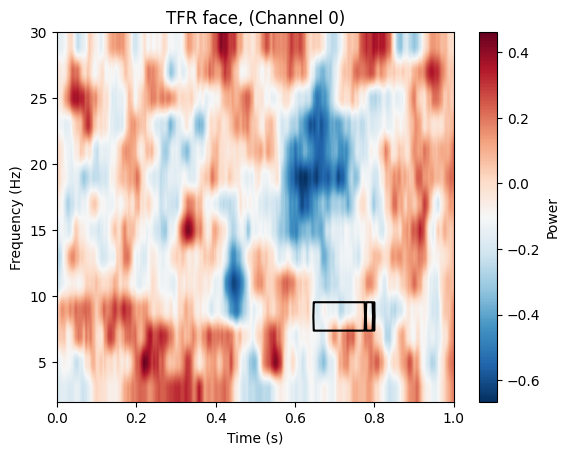

(14, 500)


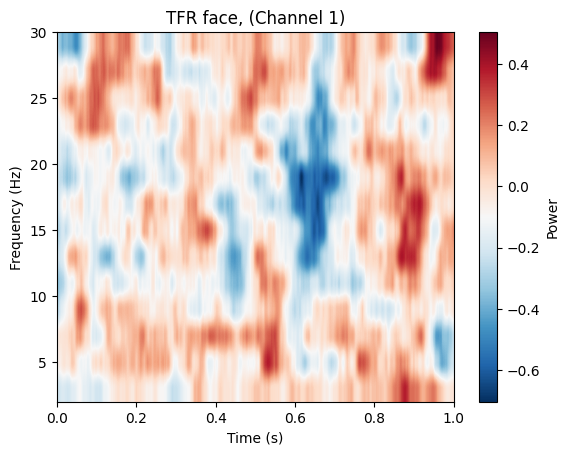

(14, 500)


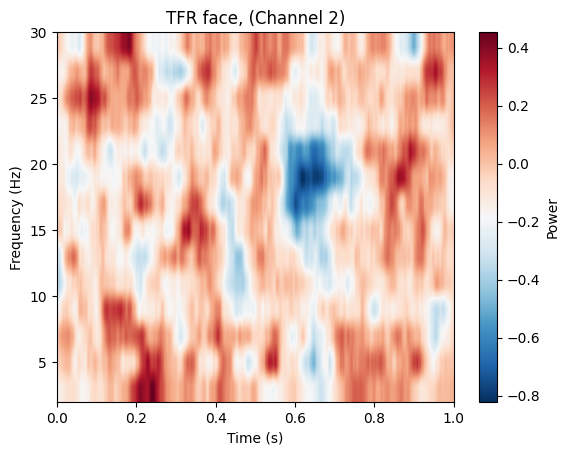

(14, 500)


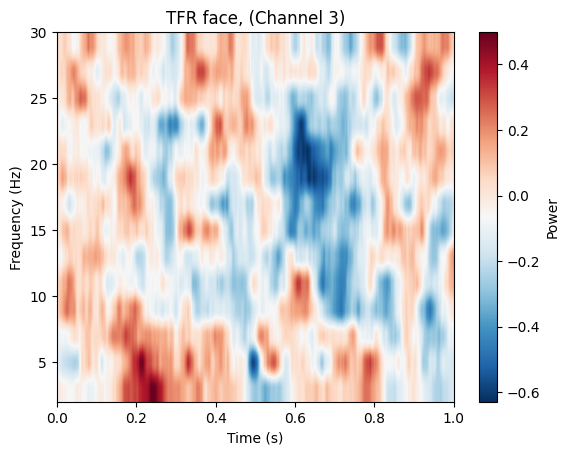

(14, 500)


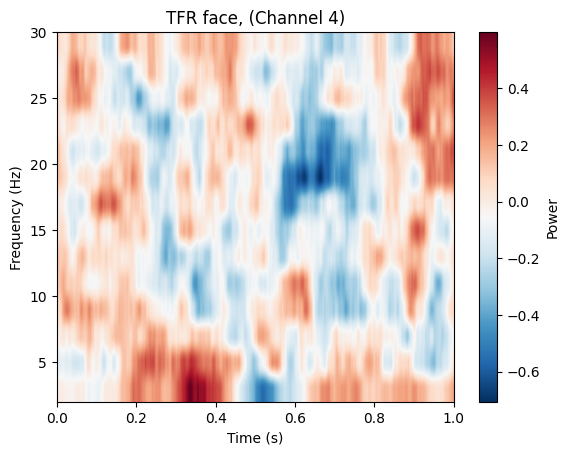

(14, 500)


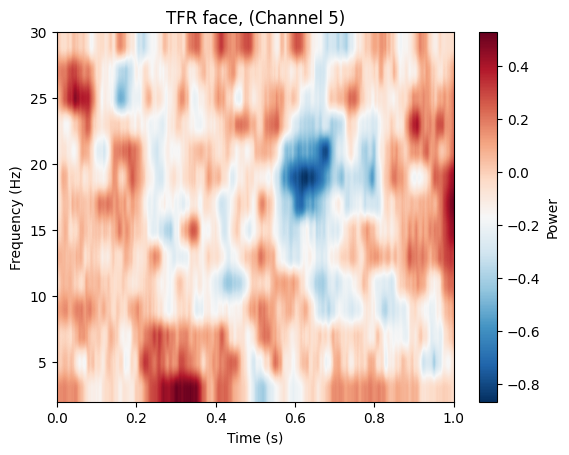

(14, 500)


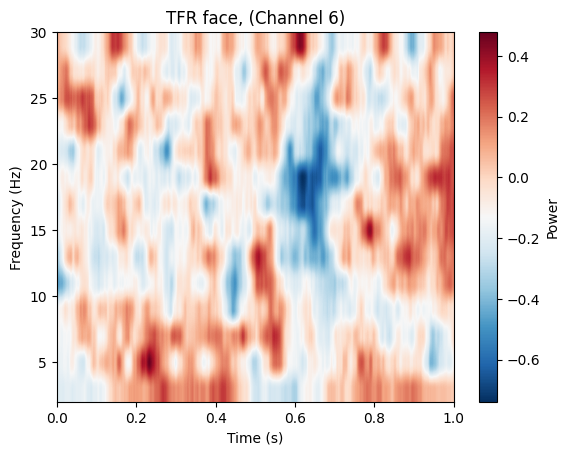

(14, 500)


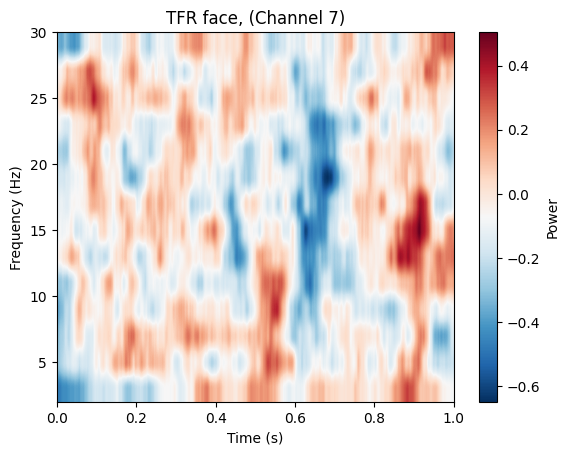

(14, 500)


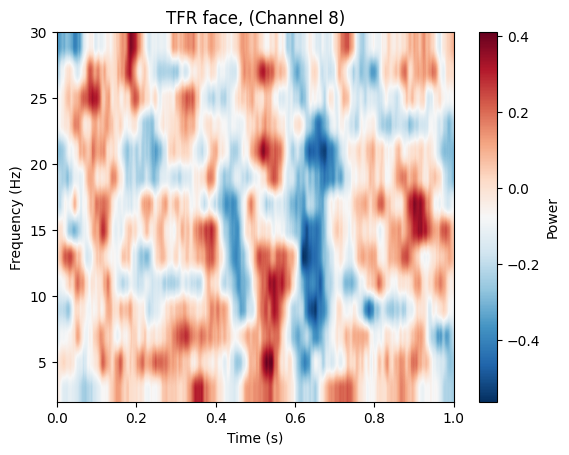

(14, 500)


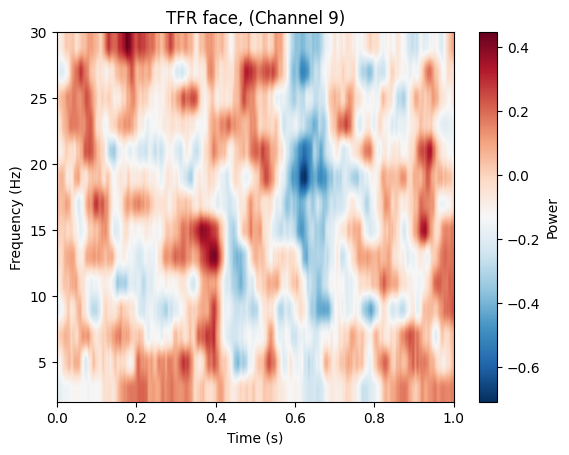

(14, 500)


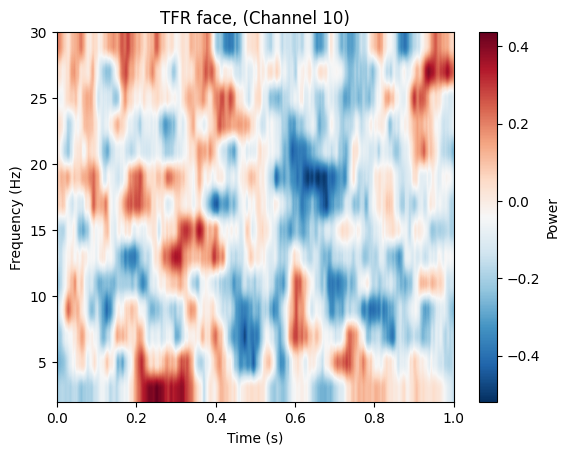

(14, 500)


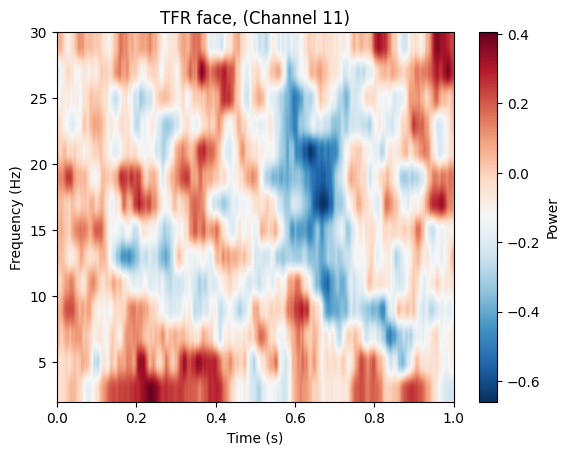

(14, 500)


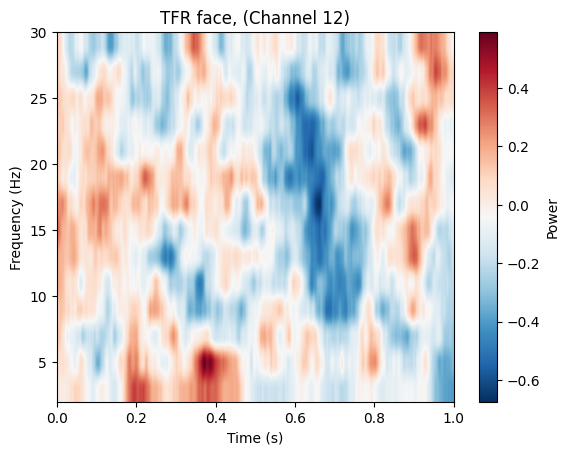

(14, 500)


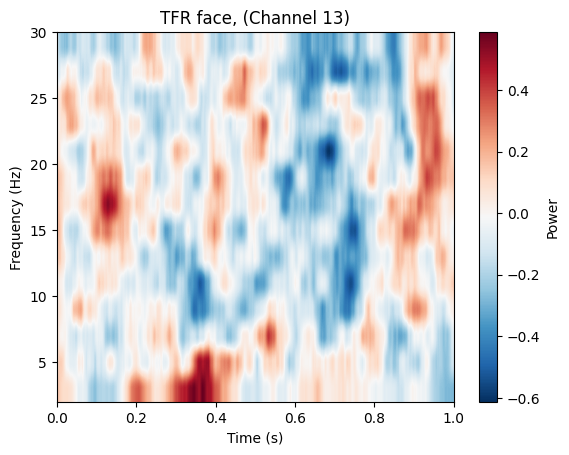

(14, 500)


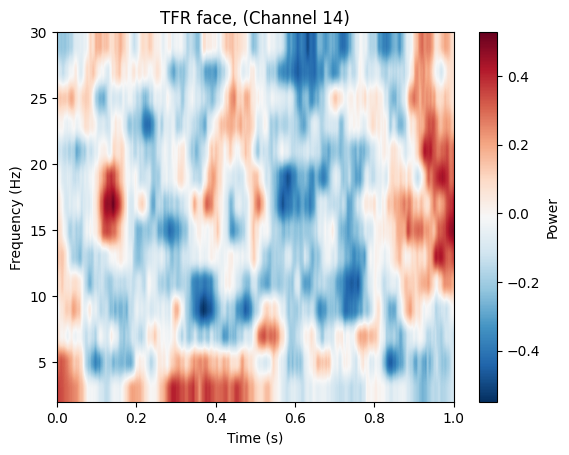

(14, 500)


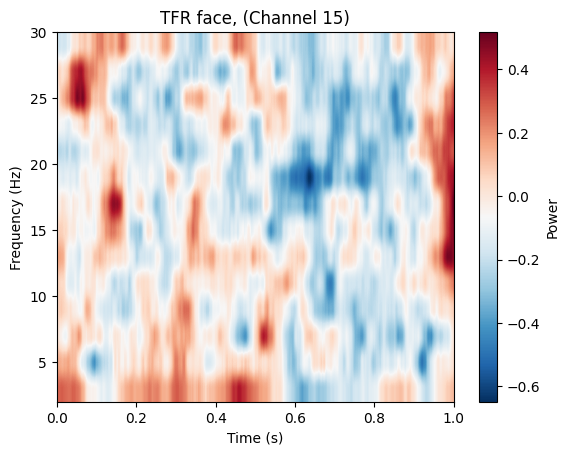

(14, 500)


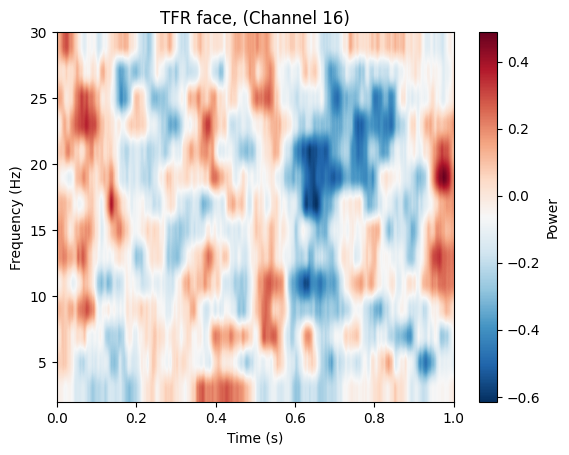

(14, 500)


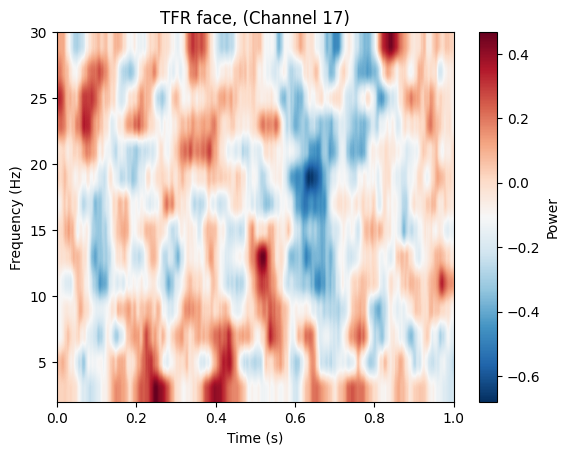

(14, 500)


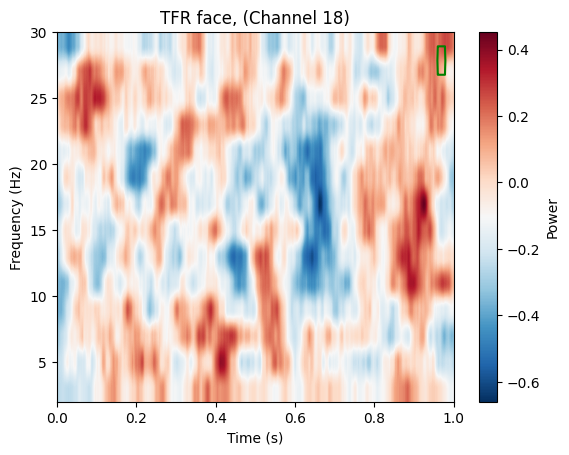

(14, 500)


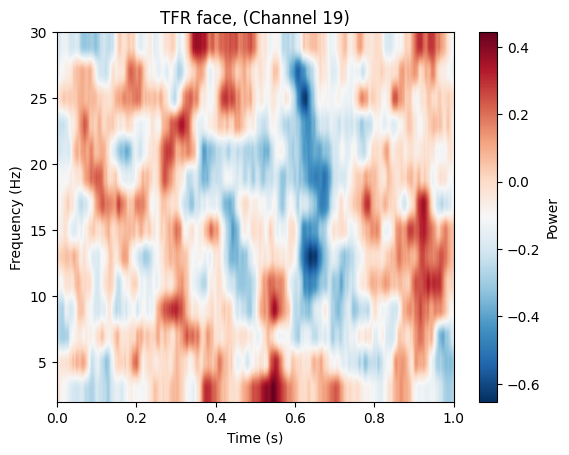

(14, 500)


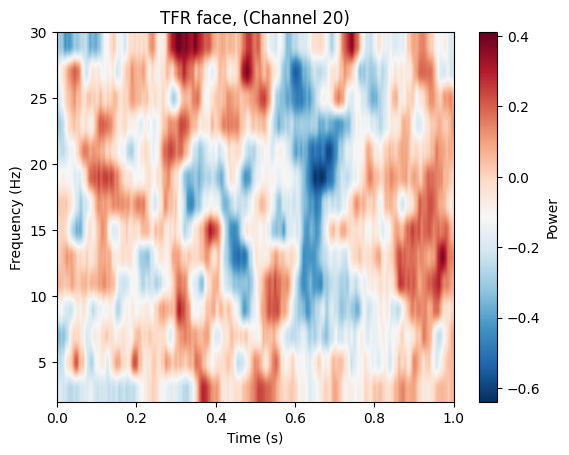

(14, 500)


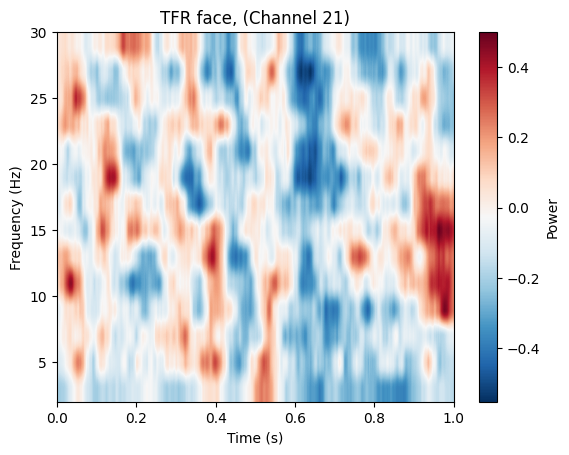

KeyboardInterrupt: 

In [83]:
# plt.figure()

# channel = 56 - 1

# for channel in np.arange(0,59):
#     n_frequencies, n_times = 14,  500
#     n_channels = 59
#     s_freq = 500
#     min_freq = 2
#     max_freq = 30

#     plot_data = np.mean(np.array(diff[1]),axis=0)[channel,:,:] - np.mean(np.array(diff[0]),axis=0)[channel,:,:]

#     plot_data2 = plot_data[:,500:1000]
#     plt.imshow(plot_data[:], aspect='auto', cmap='RdBu_r', origin='lower',
#             extent=[0, n_times / s_freq, min_freq, max_freq])
#     plt.colorbar(label='Power')
#     plt.xlabel('Time (s)')
#     plt.ylabel('Frequency (Hz)')
#     plt.title(f'TFR {stim}, (Channel {channel})')


#     frequencies = np.linspace(min_freq, max_freq, num=n_frequencies)  # Frequencies from 2 to 30 Hz
#     sig_mask = clusters[4][channel,:,:]
#     sig_mask1 = clusters[301][channel,:,:]

#     print(sig_mask.shape)

#     #extended_sig_mask = np.zeros_like(plot_data2)  # Create a mask of the same shape as plot_data
#     #extended_sig_mask[2:17, :] = sig_mask


#     plt.contour(sig_mask, levels=[0.5], colors='black', linewidths=1.5, 
#                 extent=[0, n_times / s_freq, min_freq, max_freq])
#     plt.contour(sig_mask1, levels=[0.5], colors='green', linewidths=1.5, 
#                 extent=[0, n_times / s_freq, min_freq, max_freq])
#     plt.show()

In [62]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats
from mpl_toolkits.axes_grid1 import make_axes_locatable

import mne
from mne.channels import find_ch_adjacency
from mne.datasets import sample
from mne.stats import combine_adjacency, spatio_temporal_cluster_test
from mne.viz import plot_compare_evokeds

adjacency, ch_names = find_ch_adjacency(info, ch_type="eeg")

print(type(adjacency))  # it's a sparse matrix!

mne.viz.plot_ch_adjacency(info, adjacency, ch_names)

tfr_adjacency = combine_adjacency(diff.shape[0], 500, adjacency)

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 59
<class 'scipy.sparse._csr.csr_matrix'>


AttributeError: 'list' object has no attribute 'shape'

In [63]:
import numpy as np

def find_significant_regions(significant_mask, sfreq=500):
    """
    Extract pairs of time points where the significant mask is True.
    
    Parameters:
    - significant_mask (ndarray): Boolean array indicating significant clusters.
    - sfreq (float): Sampling frequency of the data (default is 500 Hz).
    
    Returns:
    - highlights (list of tuples): List of time points (start, end) for significant regions.
    """
    highlights = []
    
    # Calculate time resolution (assuming each index corresponds to 2 ms)
    time_resolution = 2 / 1000  # or adjust this based on your time step
    
    # Find regions where the significant mask is True over any cluster
    mask_flat = np.any(significant_mask, axis=0)  # Reduce mask to 1D by checking any True across clusters

    # Identify where the significant regions start and end
    starts = np.where(np.diff(mask_flat.astype(int)) == 1)[0] + 1  # +1 to get the first True
    ends = np.where(np.diff(mask_flat.astype(int)) == -1)[0]       # Get the last True
    
    # Handle the case where True regions extend to the end of the array
    if mask_flat[0]:
        starts = np.insert(starts, 0, 0)  # If the first element is True, start at 0
    if mask_flat[-1]:
        ends = np.append(ends, len(mask_flat) - 1)  # If the last element is True, end at the last index
    
    # Convert indices to time points using the time resolution
    for start, end in zip(starts, ends):
        start_time = start * time_resolution
        end_time = end * time_resolution
        highlights.append((start_time, end_time))  # Directly in seconds, no further division needed
    
    if highlights == []:
        highlights = [0, 0]
    return highlights

# Example usage
highlights = find_significant_regions(this_freq_mask, sfreq=500)

# Output the significant regions
print("Significant regions (in seconds):", highlights)


Significant regions (in seconds): [0, 0]


In [59]:
# COLLECT DATA
data1 = np.array(diff[0])
data2 = np.array(diff[1])
print(data1.shape)

data1 = data1[:,:,:,500:1000].transpose(0,3,2,1)
data2 = data2[:,:,:,500:1000].transpose(0,3,2,1)

(33, 59, 14, 1250)


In [60]:
data2.transpose(0,3,2,1)
data1.transpose(0,3,2,1)
print(data1.shape)

(33, 500, 14, 59)


In [64]:
diff = []
all_diffs = []
stims = ['face','house']
for stim in stims: 

    with open(f'TF_Data_Phase1VsPhase2_{stim}_minus_noise.pkl', 'rb') as f:
        all_diffs.append(pickle.load(f))


In [65]:
print(all_diffs.shape)

AttributeError: 'list' object has no attribute 'shape'

In [40]:
from mne.stats import combine_adjacency, spatio_temporal_cluster_test


all_diffs = np.array(all_diffs)
# RUN TIME FREQUENCY CLUSTER

#tf_data1 = make_time_frequency(data1,[2,30])
#tf_data2 = make_time_frequency(data2,[2,30])

# Run the cluster-based permutation test

# data1_mean = np.mean(data1,axis=0)
# data2_mean = np.mean(data2,axis=0)

#data2.transpose(0,2,1)


# print(data1.shape)
# T_obs, clusters, cluster_p_values, Ho = spatio_temporal_cluster_test(
#     [data2.transpose(0,3,2,1), data1.transpose(0,3,2,1)], n_permutations=1000, tail=1, n_jobs=-1, threshold=None,buffer_size=None,
#     out_type='mask',adjacency=tfr_adjacency)

# tf_cluster_data = {'T_obs':T_obs,'clusters':clusters,'cluster_p_values':cluster_p_values,'H0':Ho}

# print(T_obs.shape)
# print(len(clusters))
# with open(f'Cluster_Analysis_TF_phase1Vsphase2_{stim} _minus_noise.pkl', 'wb') as f:
#     pickle.dump((tf_cluster_data), f)


# RUN CLUSTER ANALYSIS

import scipy.stats

n_conditions = all_diffs.shape[1]
n_observations = all_diffs.shape[2]

pval = 0.01  # arbitrary
dfn = n_conditions - 1  # degrees of freedom numerator
dfd = n_observations - n_conditions  # degrees of freedom denominator
thresh = scipy.stats.f.ppf(1 - pval, dfn=dfn, dfd=dfd)  # F distribution
print(thresh)

threshold_tfce = dict(start=0, step=0.2)

stims = ['face','house','noise']
all_cluster_data = []
for i, diff in enumerate(all_diffs):
    data1 = np.array(diff[0])
    print(data1.shape)
    data2 = np.array(diff[1])

    # Define Variables
    start_time = 200
    time0 = 500
    time1 = 1000

    sig = 0.05

    # Run the cluster-based permutation test
    data1_mean = np.mean(data1,axis=0)
    clu_data1_mean = data1[:,:,:,time0:time1]
    print(clu_data1_mean.shape)

    data2_mean = np.mean(data2[:,:,:,time0:time1],axis=0)
    clu_data2_mean = data2[:,:,:,time0:time1]
    print(clu_data2_mean.shape)

    time_adjacency = combine_adjacency((time1-time0)*data1.shape[2],adjacency)
    #tfr_adjacency = combine_adjacency(diff.shape[1:2], 500, adjacency)

    T_obs, clusters, cluster_p_values, Ho = spatio_temporal_cluster_1samp_test(
        [clu_data2_mean.transpose(0,3,2,1), clu_data1_mean.transpose(0,3,2,1)], n_permutations=1000, tail=1, n_jobs=-1, buffer_size=None, 
        out_type='mask',adjacency=time_adjacency,threshold=thresh,max_step=1)

    cluster_data = {'T_obs':T_obs,'clusters':clusters,'cluster_p_values':cluster_p_values,'H0':Ho}
    all_cluster_data.append(cluster_data)

    print(T_obs.shape)
    print(len(clusters))
    with open(f'Cluster_Analysis_phase1Vsphase2_{stims[i]}.pkl', 'wb') as f:
        pickle.dump((cluster_data), f)

with open(f'All_IB_Cluster_Analysis_phase1Vsphase2_{stims[i]}.pkl', 'wb') as f:
        pickle.dump((all_cluster_data), f)

7.529766054844182
(33, 59, 14, 1250)
(33, 59, 14, 500)
(33, 59, 14, 500)
stat_fun(H1): min=0.000000 max=32.026274
Running initial clustering …
Found 4037 clusters


c:\ProgramData\anaconda3\envs\tensorflow-gpu\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
100%|██████████| Permuting : 999/999 [02:50<00:00,    5.87it/s]


(500, 14, 59)
4037
(33, 59, 14, 1250)
(33, 59, 14, 500)
(33, 59, 14, 500)
stat_fun(H1): min=0.000000 max=25.683472
Running initial clustering …
Found 4011 clusters


100%|██████████| Permuting : 999/999 [02:46<00:00,    6.02it/s]


(500, 14, 59)
4011


In [60]:
freqs = [[2,6],[8,12],[14,20],[22,30]]
freqs_names = ['Theta','Alpha','Low Beta','High Beta']
sig_cluster = []

true_time0 = (time0 - 500)*2/1000
true_time1 = (time1 - 500)*2/1000

disp_times = np.arange(0.2,0.9,0.1)
for j, diff in enumerate(all_diffs):

    tf_diff_data = diff[1] - diff[0]
    tf_diff_data = np.mean(tf_diff_data,axis=0)
    print(tf_diff_data.shape)
    for i,freq in enumerate(freqs):
        plot_times = []
    
        low = int((freq[0]/2)-1)
        print(int(low))
        high = int((freq[1]/2)-1)
        print(int(high))
        
        significant_mask = np.zeros_like(T_obs, dtype=bool)
        count = 0
        highlights = []
        for i_c, c in enumerate(clusters):
            if cluster_p_values[i_c] <= 0.01:
                sig_cluster.append(c)
                first_index, last_index = find_first_last_true(c)
                #highlights.append([(first_index)*2/1000,(last_index)*2/1000])
                count = count + 1
                significant_mask[c] = True

                # Calculate beginning, middle, and end for the highlighted region
                start_time = first_index * 2 / 1000
                end_time = last_index * 2 / 1000
                middle_time = (start_time + end_time) / 2

                # Option 1: 25th and 75th percentiles
                start_time2 = start_time + 0.25 * (end_time - start_time)  # 25% into the highlighted region
                end_time2 = start_time + 0.75 * (end_time - start_time)    # 75% into the highlighted region
                middle_time2 = (start_time + end_time) / 2                 # Middle point between 25th and 75th percentiles
                # Append the times to be plotted
                plot_times.extend([start_time2, middle_time2, end_time2])
        
        mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k', linewidth=0, markersize=8,alpha= 1)
        this_freq_mask = np.sum(np.take(significant_mask, np.arange(int(low), int(high)), axis=1), axis=1)
        print(this_freq_mask.shape)
        highlights = find_significant_regions(this_freq_mask, sfreq=500)
    
        topomap_args = {'mask':this_freq_mask,'mask_params':mask_params}
        ts_args = dict(units=dict(eeg='Decibels'),unit=True,ylim=dict(eeg=[-1000000, 1000000]),highlight=highlights)
        
        data = np.mean(np.take(tf_diff_data[:,:,500:1000],np.arange(int(low),int(high)),axis=1),axis=1)
        print(data.shape)
        evoked = mne.EvokedArray(data, info, tmin=true_time0)
        fig = evoked.plot_joint(title=f'TF for {stim} at {freqs_names[i]}',topomap_args=topomap_args,ts_args=ts_args)
        #fig.set_size_inches(40, 40)

        plt.show


        #fig.title(f'TF for mean freq {low} and {high}')
        
        # if significant_mask.any():
        #     mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k', linewidth=0, markersize=5)
        #     plot_topomap(np.mean(data,axis=1), info, show=False,
        #                 mask=np.take(significant_mask,np.arange(int(low),int(high)),axis=1), mask_params=mask_params)


(59, 14, 1250)
0
2
(500, 59)
(59, 500)
No projector specified for this dataset. Please consider the method self.add_proj.


IndexError: index 114 is out of bounds for axis 1 with size 59

In [72]:
stim = 'house'

with open(f'Cluster_Analysis_TF_phase1Vsphase2_{stim} _minus_noise.pkl', 'rb') as f:
    tf_cluster_data = pickle.load(f)

T_obs = tf_cluster_data['T_obs']
clusters = tf_cluster_data['clusters']
cluster_p_values = tf_cluster_data['cluster_p_values']
Ho = tf_cluster_data['H0']

In [61]:
for i, clu in enumerate(clusters):
    if cluster_p_values[i] < 0.05:
        print(i)

print(np.sum(cluster_p_values < 0.05))


41
233
245
284
322
491
579
582
631
653
656
657
661
798
799
884
887
901
18


(500, 14, 59)


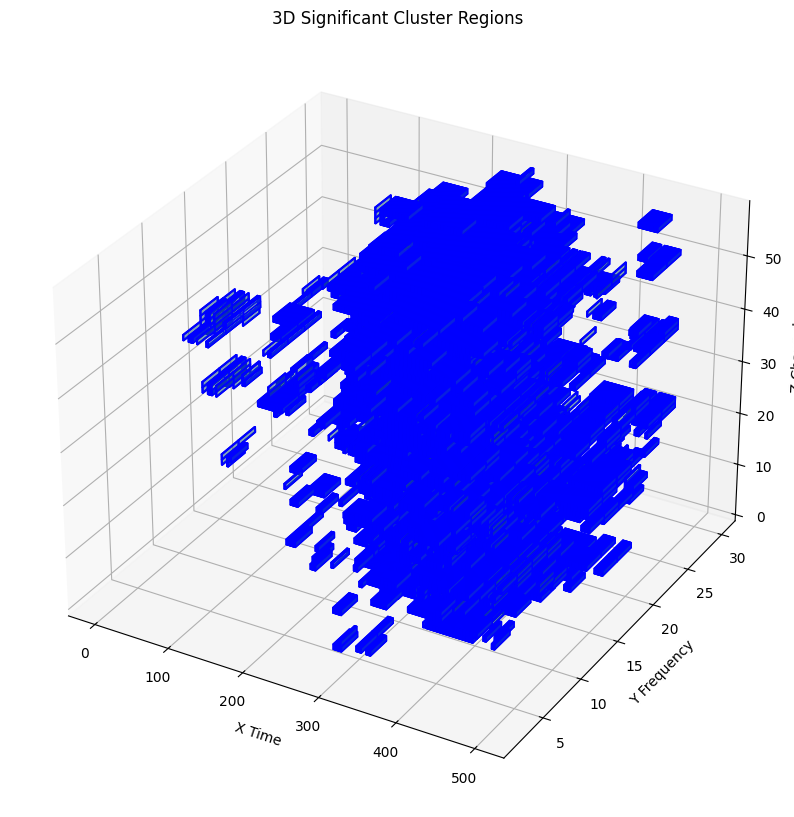

In [161]:
n_frequencies, n_times = 14,  500
n_channels = 59
s_freq = 500
min_freq = 2
max_freq = 30

for i, clu in enumerate(clusters):
    if cluster_p_values[i] < 0.01:

        # Create a 3D plot
        fig = plt.figure(figsize=(10, 12))
        ax = fig.add_subplot(111, projection='3d')

        # Create meshgrid for the plot
        print(clusters[i].shape)
        Y, Z, X = np.meshgrid(np.arange(2,32,2),np.arange(n_channels+1),np.arange(n_times+1))
        data = clusters[i].transpose(2,1,0)

        # Plot the 3D contour where `clusters == 1` (significant regions)
        ax.voxels(X, Y, Z, clusters[i].transpose(2,1,0), edgecolor='b', alpha=0.3)  # Voxel plot for 3D Boolean blocks

        # Label axes
        ax.set_xlabel('X Time')
        ax.set_ylabel('Y Frequency')
        ax.set_zlabel('Z Channel')

        plt.title('3D Significant Cluster Regions')
        plt.show()

In [173]:
significant_mask.shape

(59, 14, 500)

In [172]:
print(this_freq_mask.shape)

(14, 500)


In [41]:
# This function to find the first and last true index in the cluster to highlight the significant areas

def find_first_last_true(bool_array):

    nonzero_indices = np.nonzero(bool_array)[0]  # Get indices of True values

    if len(nonzero_indices) > 0: 

        first_true_index = nonzero_indices[0]  # First True index

        last_true_index = nonzero_indices[-1]  # Last True index

        return first_true_index, last_true_index

    else:

        return None, None  # No True values found

In [78]:
# Plot the significant clusters
times = np.arange(data1.shape[1]) / sfreq  # Convert to seconds
significant_mask = np.zeros_like(T_obs, dtype=bool)
count = 0
sig = 0.05

highlights = []
for i_c, c in enumerate(clusters):
    if cluster_p_values[i_c] <= sig:
        first_index, last_index = find_first_last_true(c)
        print(first_index,last_index)

        highlights.append([(first_index)*2/1000,(last_index)*2/1000])
        print(highlights)
        significant_mask[c] = True
        #ax[0].axvspan(np.min(np.where(c)[0]), np.max(np.where(c)[0]), alpha=0.3,color = cmap.colors[count], label=f'Cluster {i_c}')

2 14
[[0.004, 0.028]]
13 21
[[0.004, 0.028], [0.026, 0.042]]
14 35
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07]]
17 29
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058]]
20 28
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058], [0.04, 0.056]]
31 43
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058], [0.04, 0.056], [0.062, 0.086]]
36 44
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058], [0.04, 0.056], [0.062, 0.086], [0.072, 0.088]]
36 45
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058], [0.04, 0.056], [0.062, 0.086], [0.072, 0.088], [0.072, 0.09]]
39 47
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058], [0.04, 0.056], [0.062, 0.086], [0.072, 0.088], [0.072, 0.09], [0.078, 0.094]]
40 52
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058], [0.04, 0.056], [0.062, 0.086], [0.072, 0.088], [0.072, 0.09], [0.078, 0.094], [0.08, 0.104]]
40 48
[[0.004, 0.028], [0.026, 0.042], [0.028, 0.07], [0.034, 0.058],

Significant regions (in seconds): [0, 0]


0
2
(59, 500)
No projector specified for this dataset. Please consider the method self.add_proj.


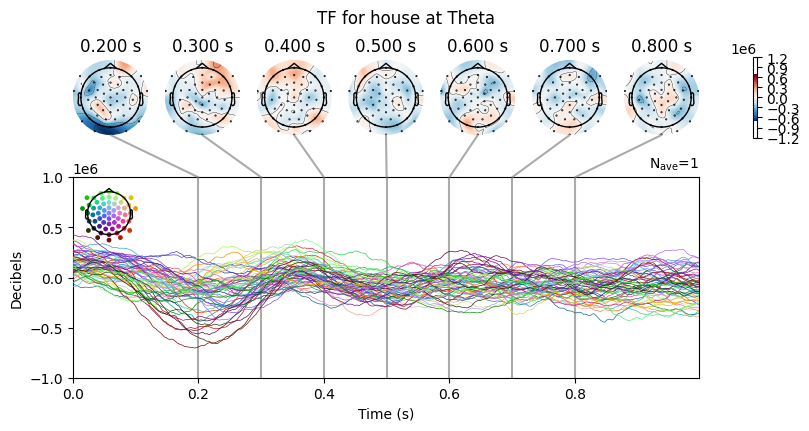

3
5
(59, 500)
No projector specified for this dataset. Please consider the method self.add_proj.


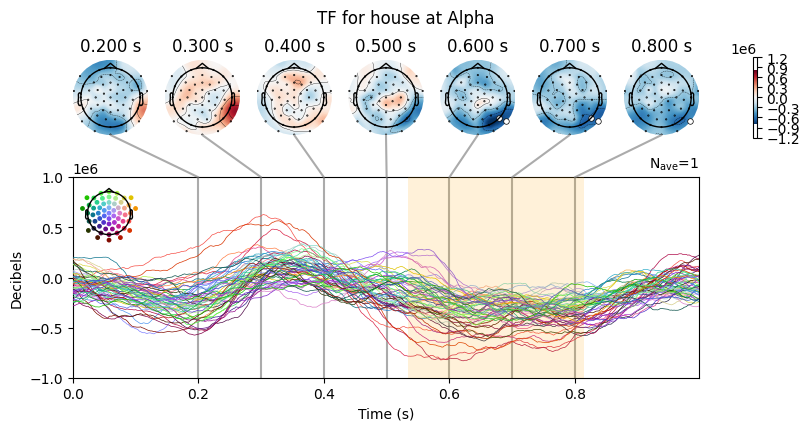

6
9
(59, 500)
No projector specified for this dataset. Please consider the method self.add_proj.


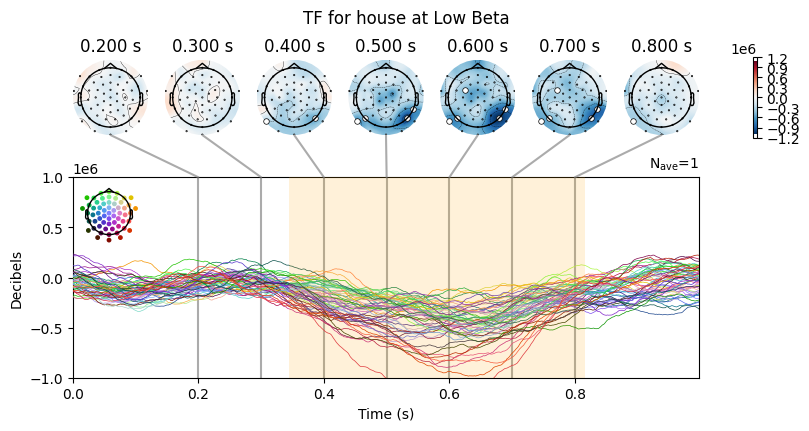

10
14
(59, 500)
No projector specified for this dataset. Please consider the method self.add_proj.


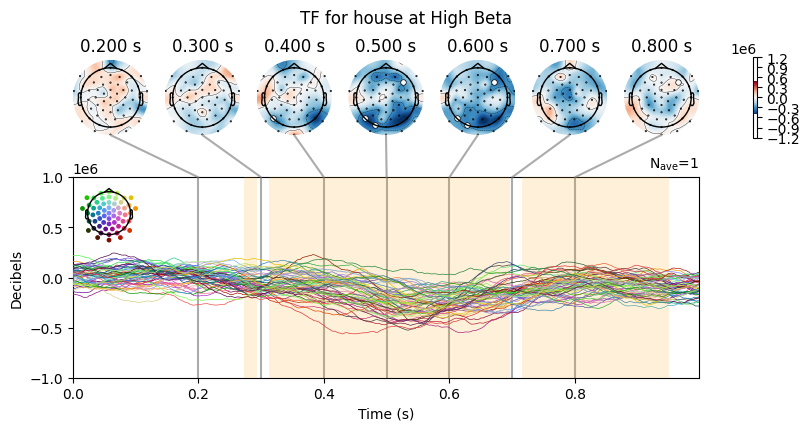

In [85]:
freqs = [[2,6],[8,12],[14,20],[22,30]]
freqs_names = ['Theta','Alpha','Low Beta','High Beta']
sig_cluster = []

disp_times = np.arange(0.2,0.9,0.1)

for i,freq in enumerate(freqs):
   
    low = int((freq[0]/2)-1)
    print(int(low))
    high = int((freq[1]/2)-1)
    print(int(high))
    
    significant_mask = np.zeros_like(T_obs, dtype=bool)
    count = 0
    highlights = []
    for i_c, c in enumerate(clusters):
        if cluster_p_values[i_c] <= 0.01:
            sig_cluster.append(c)
            first_index, last_index = find_first_last_true(c)
            #highlights.append([(first_index)*2/1000,(last_index)*2/1000])
            count = count + 1
            significant_mask[c] = True
    
    mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k', linewidth=0, markersize=8,alpha= 1)
    this_freq_mask = np.sum(np.take(significant_mask, np.arange(int(low), int(high)), axis=1), axis=1)
    print(this_freq_mask.shape)
    highlights = find_significant_regions(this_freq_mask, sfreq=500)
   
    topomap_args = {'mask':this_freq_mask,'mask_params':mask_params}
    ts_args = dict(units=dict(eeg='Decibels'),unit=True,ylim=dict(eeg=[-1000000, 1000000]),highlight=highlights)

    data = np.mean(np.take(tf_diff_data[:,:,500:1000],np.arange(int(low),int(high)),axis=1),axis=1)
    evoked = mne.EvokedArray(data, info, tmin=0)
    fig = evoked.plot_joint(times=disp_times,title=f'TF for {stim} at {freqs_names[i]}',topomap_args=topomap_args,ts_args=ts_args)
    #fig.set_size_inches(40, 40)

    plt.show


    #fig.title(f'TF for mean freq {low} and {high}')
    
    # if significant_mask.any():
    #     mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k', linewidth=0, markersize=5)
    #     plot_topomap(np.mean(data,axis=1), info, show=False,
    #                 mask=np.take(significant_mask,np.arange(int(low),int(high)),axis=1), mask_params=mask_params)


In [86]:
print(cluster_p_values)

[1. 1. 1. ... 1. 1. 1.]


In [29]:

significant_mask = np.zeros_like(clusters[0], dtype=bool)
count = 0
for i_c, c in enumerate(clusters):
    if cluster_p_values[i_c] <= 0.05:
        count = count + 1
        significant_mask[c] = True

In [51]:
sum(cluster_p_values < 0.05)

1

(59, 14, 1250)


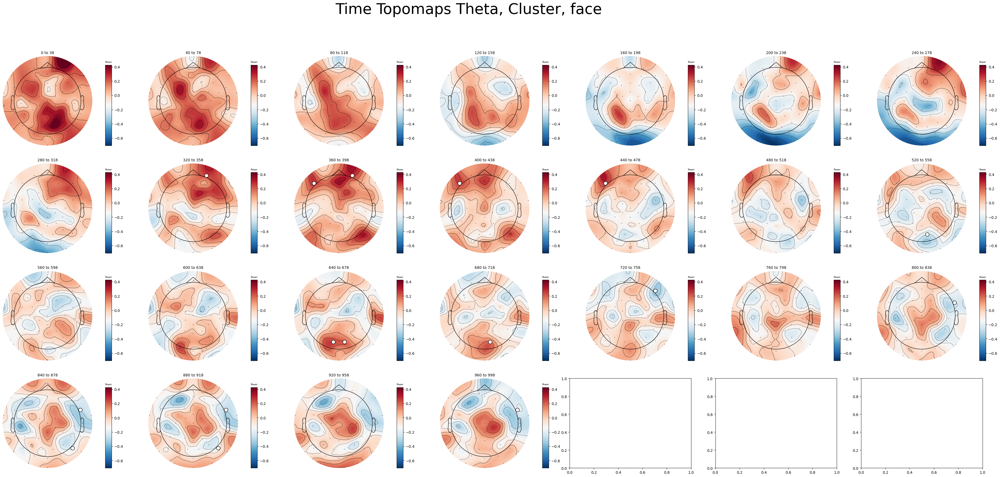

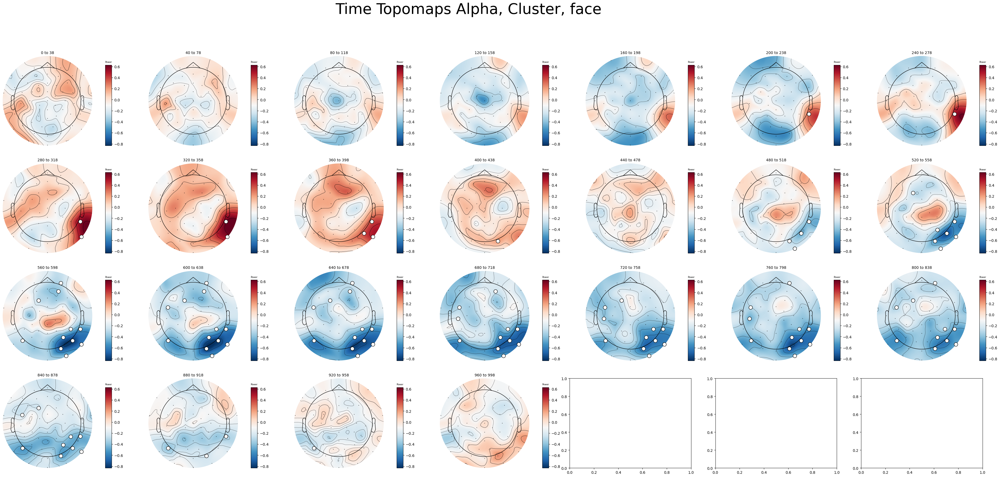

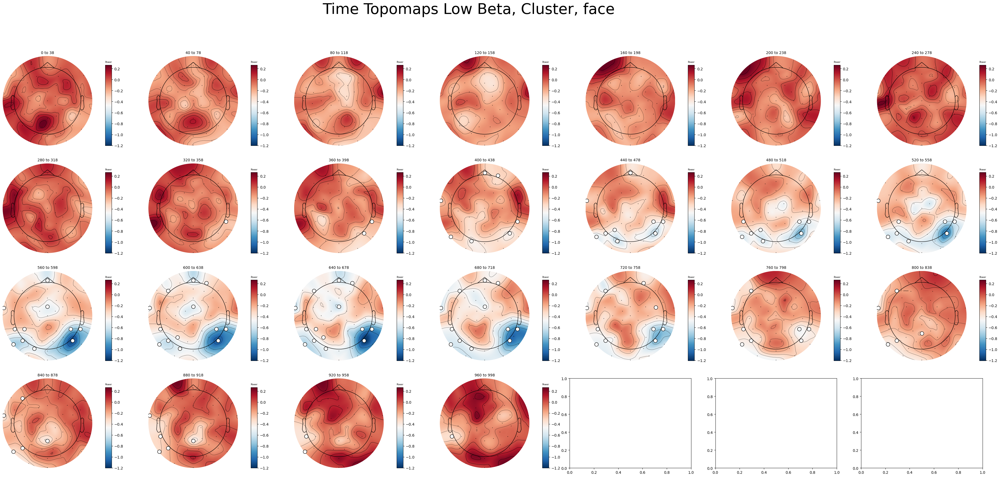

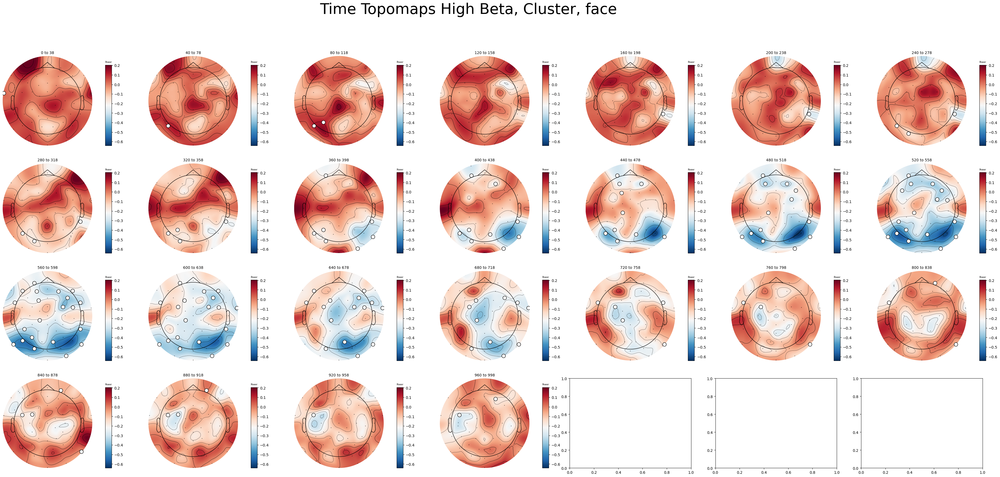

In [139]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from mne.viz import plot_topomap
import numpy as np
import matplotlib.pyplot as plt



data1 = np.array(diff[0])
data2 = np.array(diff[1])

steps = 20
time0 = 0
time1 = 500

plot_times = [np.arange(i, i+steps) for i in range(time0, time1, steps)]
topomap_data = np.mean(data2, axis=0) - np.mean(data1, axis=0)

# Frequency bands and their names
freqs = [[2, 6], [8, 12], [14, 18], [20, 30]]
freqs_names = ['Theta', 'Alpha', 'Low Beta', 'High Beta']

print(topomap_data.shape)

# Plot significant clusters
#for k, clu in enumerate(clusters):
#if cluster_p_values[k] < 0.05:
for i, freq in enumerate(freqs):
        
    num_of_rows = 4
    fig, ax = plt.subplots(num_of_rows, int(len(plot_times)/num_of_rows)+1, figsize=(8*int(len(plot_times)/num_of_rows), 20))
    ax = ax.flatten()

    low = int((freq[0]/2)-1)
    high = int((freq[1]/2)-1)
    fig.suptitle(f'Time Topomaps {freqs_names[i]}, Cluster, {stim}', fontsize=40)
    
    #fig.suptitle(f'Time Topomaps {freqs_names[i]}, Cluster {k}, {stim}', fontsize=40)

    # Mask and data for the specific frequency range
    this_freq_mask = np.max(np.take(significant_mask, np.arange(int(low), int(high)), axis=1), axis=1)
    this_freq_data = np.mean(np.take(tf_diff_data[:,:,500:1000], np.arange(int(low), int(high)), axis=1), axis=1)

    local_min = this_freq_data.min()
    local_max = this_freq_data.max()

    for j, time_erp in enumerate(plot_times):
        this_ax = ax[j]
        this_mask = np.take(this_freq_mask, np.arange(time_erp[0], time_erp[1]), axis=1)
        this_topomap_data = np.mean(np.take(this_freq_data, np.arange(time_erp[0], time_erp[1]), axis=1), axis=1)
        # Calculate global min and max for color scale across all topomaps

        # Mask parameters for significant areas
        mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k', linewidth=0, markersize=10, alpha=1)

        # Plot with global min/max and view from the back
        im, cm = plot_topomap(this_topomap_data, info, show=False, axes=this_ax, mask=this_mask,
                                mask_params=mask_params, vlim=[local_min,local_max],extrapolate='head',sphere=(0.0,0.0,0.0,0.09))  # Back view

        pos = this_ax.get_position()
        time1 = time_erp[0] * 2
        time2 = np.max(time_erp) * 2
        this_ax.set_title(f'{time1} to {time2}', fontsize=10)

        # Adjust colorbar relative to topomap
        cbar_ax = fig.add_axes([pos.x1 + 0.01, pos.y0, 0.005, pos.height * 0.9])
        clb = plt.colorbar(im, cax=cbar_ax)
        clb.ax.set_title(f'Power', fontsize=6)

    #fig.savefig(f'Time Topomaps {freqs_names[i]}, Cluster {k}, {stim}.png', format='png')
    fig.savefig(f'Time Topomaps {freqs_names[i]}, Cluster, {stim}.png', format='png')

plt.show()


In [232]:
np.take(tf_diff_data,[0,1,2,3],axis=1)

array([[[-0.19704495, -0.19329156, -0.19650405, ...,  0.1737539 ,
          0.17378824,  0.1747713 ],
        [-0.14710175, -0.14556706, -0.13991234, ...,  0.2111569 ,
          0.21241866,  0.21332183],
        [ 0.02708773,  0.02755278,  0.03418806, ...,  0.16944893,
          0.17879801,  0.18114049],
        [ 0.04564643,  0.04900567,  0.05352993, ...,  0.15780452,
          0.16115617,  0.16348699]],

       [[-0.23042808, -0.22725549, -0.22512513, ..., -0.01943127,
         -0.0178557 , -0.01578245],
        [-0.09973798, -0.09247051, -0.08465445, ..., -0.21849322,
         -0.2137474 , -0.2081803 ],
        [-0.08129276, -0.06814274, -0.05796598, ..., -0.25092252,
         -0.24240441, -0.23477709],
        [-0.28124246, -0.27593051, -0.27134352, ..., -0.02121152,
         -0.01826539, -0.0172432 ]],

       [[-0.18043077, -0.1715534 , -0.16657804, ...,  0.04420692,
          0.04483815,  0.04628368],
        [-0.04834977, -0.04691989, -0.04566876, ..., -0.00677066,
         -0.

In [15]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from mne.viz import plot_topomap

steps = 20
time0 = 0
time1 = 500

plot_times = [np.arange(i, i+steps) for i in range(0, 500, steps)]
topomap_data = np.mean(data2,axis=0) - np.mean(data1,axis=0)

print(topomap_data.shape)

num_of_rows = 4
fig, ax = plt.subplots(num_of_rows, int(len(plot_times)/num_of_rows), figsize=(4*int(len(plot_times)/num_of_rows), 8))
ax = ax.flatten()

for j, time_erp in enumerate(plot_times):
    this_ax = ax[j]
    #print(time_erp)
    this_mask = significant_mask[:,:].T
    
    #this_topomap_data = topomap_data[time_erp[0],:]
    this_topomap_data = np.mean(np.take(topomap_data,time_erp,axis=1),axis=1)
    #print(this_topomap_data.shape)
    mask_params = dict(marker='o', markerfacecolor='r', markeredgecolor='k', linewidth=0, markersize=5,alpha= 0.3)

    im,cm = plot_topomap(this_topomap_data, info, show=False, axes=this_ax, mask=np.take(this_mask,time_erp,axis=0).T, mask_params=mask_params)
    
    pos = this_ax.get_position()
    time1 = (time_erp[0])  *2
    time2 = (np.max(time_erp)) *2
    this_ax.set_title(f'{time1} to {time2}',fontsize = 10)
    cbar_ax = fig.add_axes([pos.x1 + 0.01, pos.y0, 0.005, pos.height*0.9])  # Adjusted relative to topomap
    clb = plt.colorbar(im, cax=cbar_ax)
    clb.ax.set_title(f'T-score',fontsize=6) # title on top of colorbar

fig.savefig(f'Avg Progression over time ERPs {stim}.png', format='png')

NameError: name 'data2' is not defined

NameError: name 'times' is not defined

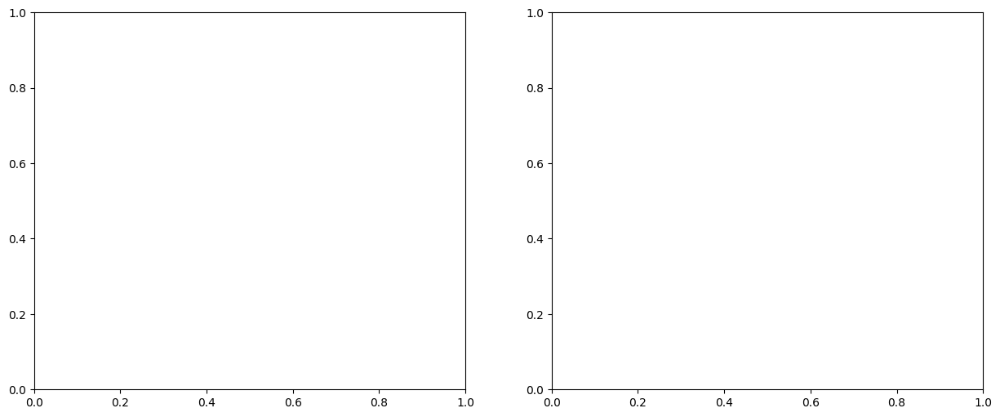

In [31]:
# Load cluster analysis data

from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from mne.viz import plot_topomap

data1_mean = np.mean(tf_diff_data[0],axis=0)
data2_mean = np.mean(tf_diff_data[1],axis=0)

# Set up the figure for plotting
fig, ax = plt.subplots(1, 2, figsize=(15, 6))

cmap = plt.get_cmap('Set1')  # Choose a colormap
norm = Normalize(vmin=times.min(), vmax=times.max())  # Normalize time to [0, 1]

# Create a colormap mappable for the colorbar (optional)
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# Plot the significant clusters
times = np.arange(seg_data1.shape[1]) / sfreq  # Convert to seconds
significant_mask = np.zeros_like(T_obs, dtype=bool)
count = 0
for i_c, c in enumerate(clusters):
    if cluster_p_values[i_c] <= 0.05:
        count = count + 1
        significant_mask[c] = True
        ax[0].axvspan(np.min(np.where(c.T)[0]), np.max(np.where(c.T)[0]), alpha=0.3,color = cmap.colors[count], label=f'Cluster {i_c}')

# Plot the ERP difference between conditions
ax[0].plot(np.arange(0,1000,2),data1_mean[44].T - data2_mean[14].T,label = 'ERP Difference')
ax[0].plot(np.arange(0,1000,2),data1_mean[44].T,label = 'ERP Data1')
ax[0].plot(np.arange(0,1000,2),data2_mean[44].T,label = 'ERP Data2')

#plt.fill_between(time_windows, min_cis[i,:,0], max_cis[i,:,1],
#    alpha=0.15, facecolor=clrs[i],label='std. error')
ax[0].set_title(f'Cluster-based Permutation Test Results Chan 8')
ax[0].set_xlabel('Time (ms)')
ax[0].set_ylabel('ERP Difference')
ax[0].legend(loc='lower right')
#ax[0].legend(['Significant Cluster'])

# Plot the topography of the first significant cluster
if significant_mask.any():
    mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k', linewidth=0, markersize=5)
    plot_topomap(np.mean(T_obs.T,axis=0), info, show=False, axes=ax[1],
                 mask=significant_mask, mask_params=mask_params)

    ax[1].set_title('Topography of Significant Clusters')

# Save and show the figure
fig.savefig(f'Topography_of_Significant_Clusters_Pz_{stim}.png', format='png')
plt.show()


C:\Users\User\AppData\Local\Temp\ipykernel_16572\870859495.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 1, figsize=(15, 6))


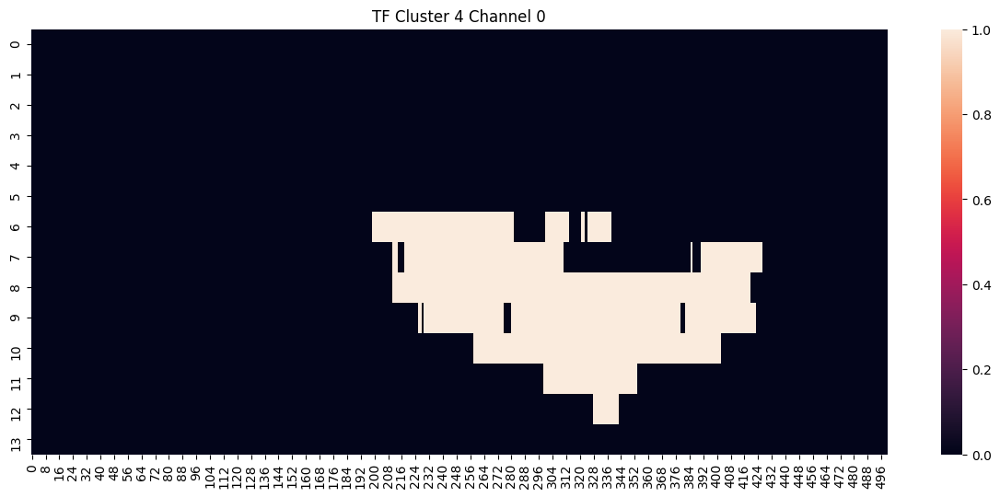

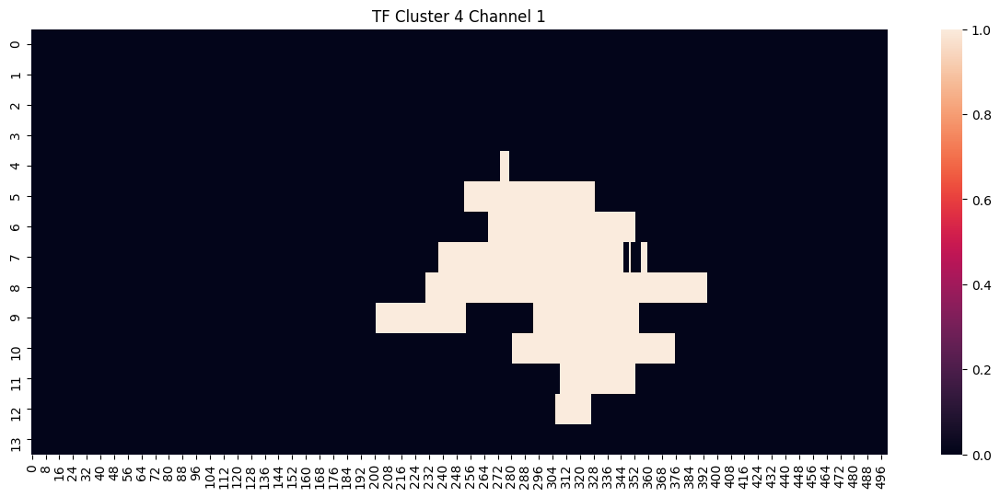

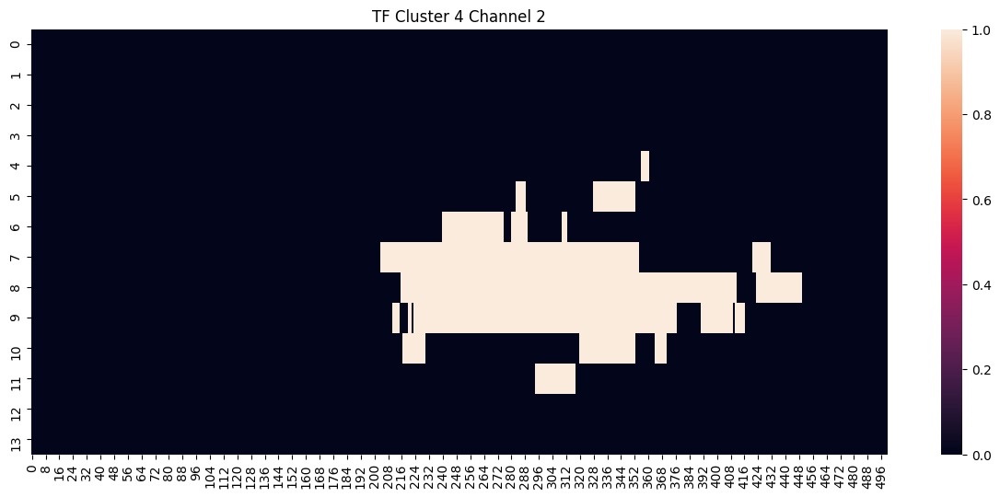

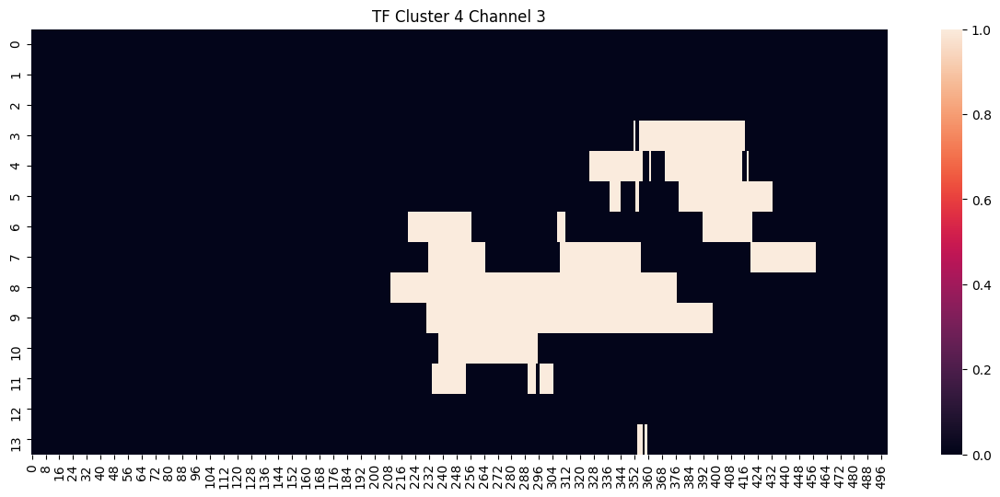

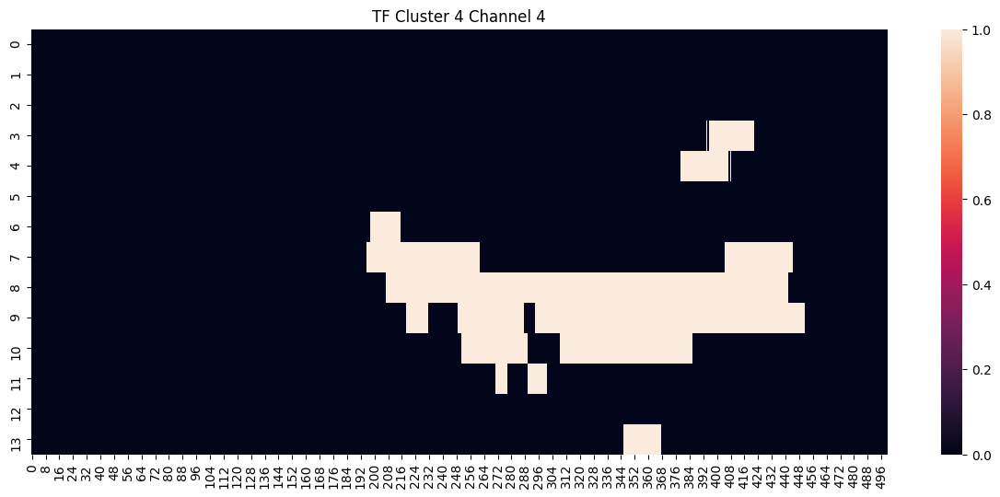

...

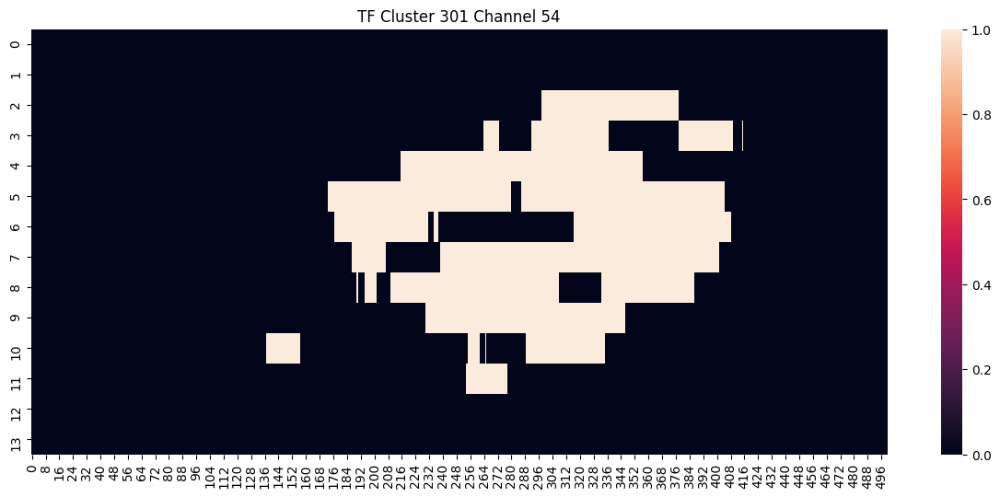

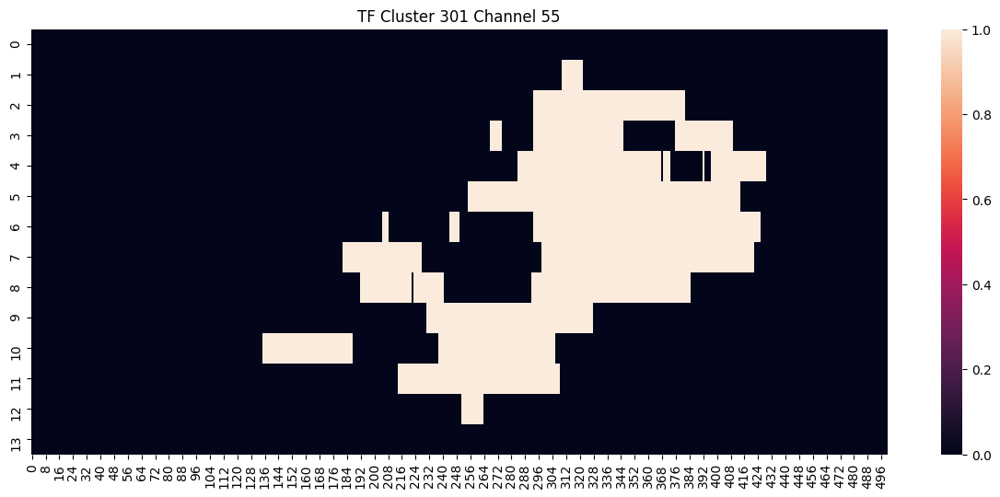

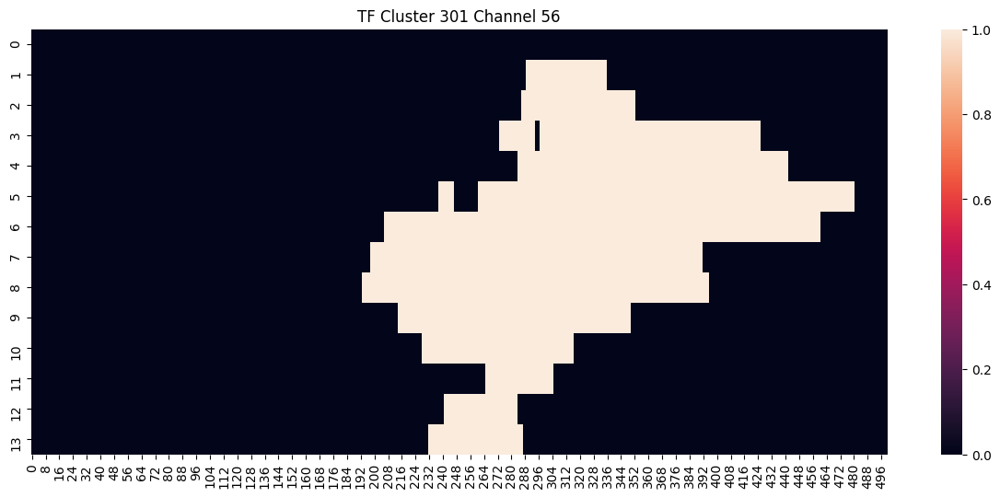

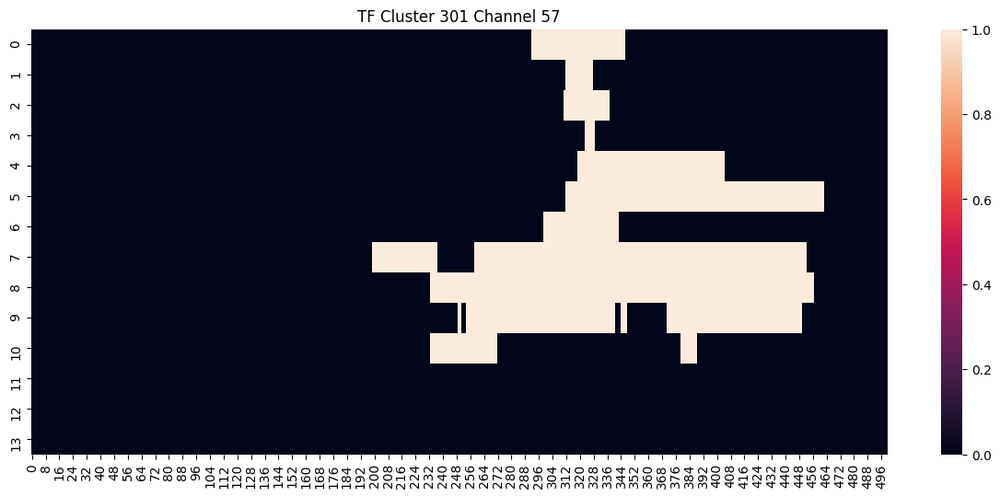

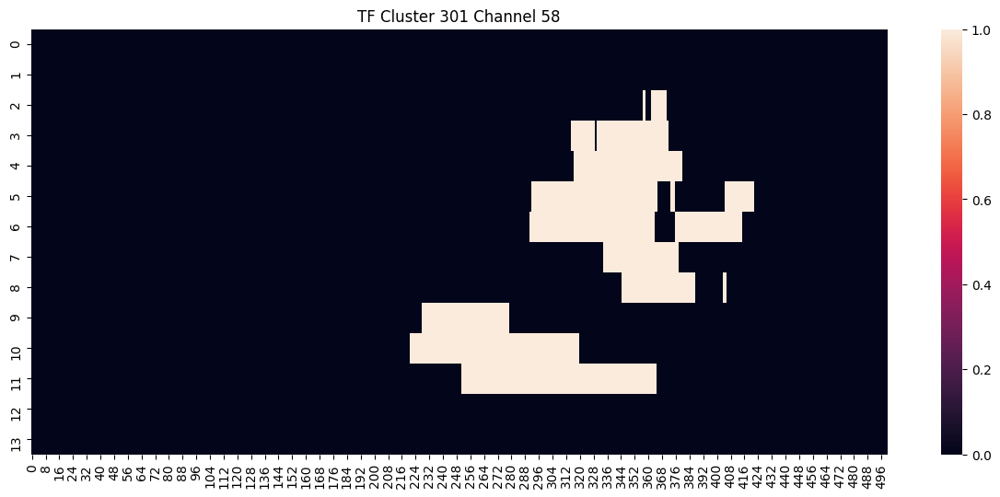

In [29]:
for i, clu in enumerate(clusters):
    if cluster_p_values[i] < 0.05:
        
        for j in range(0,59):
            fig, ax = plt.subplots(1, 1, figsize=(15, 6))
        #sns.heatmap((clusters[i][0,:,:]))
            sns.heatmap((clusters[i][j,:,:]))
            plt.title(f'TF Cluster {i} Channel {j}')

In [20]:

print(T_obs.shape)
print(len(clusters))
with open(f'Cluster_Analysis_TF_phase1Vsphase2_{stim} _minus_noise.pkl', 'wb') as f:
    pickle.dump((tf_cluster_data), f)

(59, 14, 1250)
342


In [25]:
print(len(clusters))

342


In [195]:
data1 = np.array(diff[0])
data2 = np.array(diff[1])

print(data1.shape)

IndexError: list index out of range

In [99]:
all_data_backup = copy.deepcopy(all_data)

In [100]:
all_data = copy.deepcopy(all_data_backup)

In [47]:
np.unique(all_data.subject_id)

array([  2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
        15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
        28,  34,  37,  38,  39,  41,  42,  43,  44,  45,  46,  47,  50,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  73,  74,  75,  76,  77,  78,
        80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  92,  94,
        95,  96,  97,  98,  99, 100, 101])

In [48]:
[[i,all(all_data.groups[all_data.subject_id == i])] for i in np.unique(all_data.subject_id)]

[[2, True],
 [3, False],
 [4, False],
 [5, True],
 [6, True],
 [7, False],
 [8, False],
 [9, True],
 [10, False],
 [11, True],
 [12, False],
 [13, False],
 [14, False],
 [15, False],
 [16, False],
 [17, False],
 [18, True],
 [19, False],
 [20, True],
 [21, False],
 [22, False],
 [23, True],
 [24, False],
 [25, False],
 [26, False],
 [27, False],
 [28, True],
 [34, True],
 [37, True],
 [38, True],
 [39, True],
 [41, False],
 [42, False],
 [43, True],
 [44, True],
 [45, False],
 [46, False],
 [47, False],
 [50, True],
 [52, True],
 [53, False],
 [54, False],
 [55, True],
 [56, False],
 [57, False],
 [58, True],
 [59, True],
 [60, True],
 [61, True],
 [62, False],
 [63, False],
 [64, False],
 [65, False],
 [66, True],
 [67, False],
 [68, False],
 [69, False],
 [70, True],
 [71, False],
 [73, False],
 [74, False],
 [75, False],
 [76, True],
 [77, True],
 [78, False],
 [80, True],
 [81, False],
 [82, False],
 [83, True],
 [84, False],
 [85, False],
 [86, False],
 [87, False],
 [88, False],


In [ ]:
[[i, np.mean(all_data.data[:,:,all_data.subject_id == i])] for i in np.unique(all_data.subject_id)]

[[1, 0.7890141],
 [2, 0.08327753],
 [3, 0.3029027],
 [4, 0.19564871],
 [5, 0.94696254],
 [6, -0.13643306],
 [7, 0.08683639],
 [8, 0.5642639],
 [9, -0.16198297],
 [10, 0.9127611],
 [11, 0.32975432],
 [12, 0.70748127],
 [13, 0.51057345],
 [14, 1.4392502],
 [15, 0.5832032],
 [16, 0.02123841],
 [17, 1.8127066],
 [18, 0.49922284],
 [19, 0.41885903],
 [20, -0.6353861],
 [21, 0.24485911],
 [22, 0.29866204],
 [23, 1.0940248],
 [24, 0.36723223],
 [25, 0.47339046],
 [26, 0.042282812],
 [27, 0.8277763],
 [28, -0.09710045],
 [34, 0.04663584],
 [37, 0.28802335],
 [38, 0.97155356],
 [39, 0.5934007],
 [41, 0.8275236],
 [42, -0.06183837],
 [43, 0.56109154],
 [44, 0.990496],
 [45, 0.2319367],
 [46, -0.16378558],
 [47, -0.42268777],
 [48, 0.6016544],
 [50, 0.60614],
 [51, 1.1244044],
 [52, 0.46525612],
 [53, 0.383541],
 [54, 0.25517485],
 [55, 0.58478504],
 [56, 0.78592575],
 [57, 0.66412205],
 [58, 0.7278453],
 [59, 0.53992844],
 [60, 0.17371324],
 [61, 0.94737667],
 [62, 0.66679156],
 [63, 0.19617827]

In [ ]:
np.mean([np.mean(all_data.data[:,:,all_data.subject_id == i]) for i in np.unique(all_data.subject_id)])

0.47587314

In [ ]:
print(all_data.data.shape)

(64, 500, 95504)


In [ ]:
import numpy as np
import mne

def create_mne_epochs_from_3d_array(erp_data, subject_ids, events = [], event_id = [], sfreq=1000, ch_names=None, info=None):
    """
    Create an MNE Epochs object from a 3D NumPy array of ERP data and a list of subject IDs.

    Args:
        erp_data (np.ndarray): A 3D NumPy array with dimensions (electrodes, time, trials).
        subject_ids (list): A list of subject IDs, one for each trial in the data.
        events (np.ndarray): A 2D NumPy array of events, where each row contains (sample, duration, event_id).
        event_id (dict): A dictionary mapping event descriptions to integer event IDs.
        sfreq (float, optional): The sampling frequency of the data in Hz. Default is 1000 Hz.
        ch_names (list, optional): A list of channel names. If not provided, default names will be used.
        info (mne.Info, optional): An MNE info object with additional metadata. If not provided, a default info object will be created.

    Returns:
        mne.Epochs: An MNE Epochs object.
    """
    # Get the dimensions of the input array
    n_channels, n_time, n_trials = erp_data.shape

    # Create the channel information
    if ch_names is None:
        ch_names = [f'Ch{i+1}' for i in range(n_channels)]
    if info is None:
        info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=['eeg'] * n_channels)

    # Create the Epochs object
    data = erp_data.transpose(2, 1, 0)  # Transpose to (trials, time, channels)
    epochs = mne.EpochsArray(data, info, events=events, event_id=event_id)

    # Add the subject IDs as metadata
    epochs.metadata = pd.DataFrame({'subject_id': subject_ids})

    return epochs

In [ ]:
#new_data = create_mne_epochs_from_3d_array(all_data.data, all_data.subject_id, sfreq=1000, ch_names=None, info=None)

ValueError: Info and data must have same number of channels.

In [10]:
mask = np.full(64,True)
mask[58] = False
mask[60:64] = False
# data = data[:,mask,:]
# print(data.shape)

In [ ]:
all_data = all_data_backup

In [ ]:
np.unique(all_data.subject_id)

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  34,  37,  38,  39,  41,  42,  43,  44,  45,  46,  47,
        48,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,
        62,  63,  64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,
        75,  76,  77,  78,  80,  81,  82,  83,  84,  85,  86,  87,  88,
        89,  90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101])

In [ ]:
np.unique(all_data.phase)

array(['invisible', 'visible'], dtype='<U9')

In [201]:
# THIS IS FOR 

import matplotlib
#matplotlib.use('qtagg')
diff = []
full_diffs = []
#fig, ax = plt.subplots(1, 1, figsize=(20, 10))
full_diff = []
for j, label in enumerate(np.unique(all_data.phase)):
    full_erp = []
    erps = []
    for i in np.unique(all_data.subject_id):
        #if all(all_data.labels[all_data.subject_id == i] == label):
        if all(all_data.groups[all_data.subject_id == i] == 1):
            #print(i)
            A = all_data.subject_id == i
            B = all_data.stimulus == 'face'
            D = all_data.phase == label

            E = all_data.stimulus == 'noise'
            #E = all_data.groups == 1
            C = A*B*D
            F = A*E*D

            this_data = all_data.data[:,:,C]
            this_data = this_data[mask,:,:]

            full_erp.append(average_reference(this_data))

            
            this_data_noise = all_data.data[:,:,E]
            this_data_noise = this_data_noise[mask,:,:]

            this_data_noise = average_reference(this_data_noise)
            this_data_noise = remove_baseline(this_data_noise,400,500)

            erp = np.mean(this_data, axis=2) - np.mean(this_data_noise, axis=2)
            erps.append(erp)
            #full_diff.append(full_erp)
    #full_diffs.append(full_diff)
    diff.append(erps)

    this_data2 = np.array(diff[j])
    print(this_data2.shape)

    #this_data2 = this_data.transpose[1,2,0]
    fig = plt.plot(np.arange(-1000,1500,2),this_data2[:,8,:].T)
    plt.title(f'Average ERP (Fz), face, phase {label}')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    #this_data2 = this_data2[:,:]
    print(this_data2.shape)
    plt.figure(figsize=(10, 5))
    plt.subplot(3, 1, 1)
    print(np.array(diff[j]).shape)
    fig = plt.plot(np.arange(-1000,1500,2),np.mean(this_data2,axis = 0).T)
    plt.title(f'Average ERP, face, phase {label}')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()

KeyboardInterrupt: 

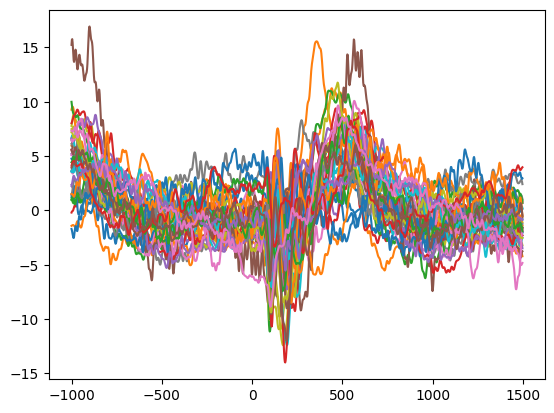

In [22]:
plt.plot(np.arange(-1000,1500,2),this_data2[:,8,:].T)

In [193]:
# THIS IS FOR SEEN VS UNSEEN

import matplotlib
#matplotlib.use('qtagg')
diff = []
full_diffs = []

full_diff = []
for j,label in enumerate(np.unique(all_data.labels)):
    full_erp = []
    erps = []
    for i in np.unique(all_data.subject_id):
        if all(all_data.labels[all_data.subject_id == i] == label):
            #print(i)
            A = all_data.subject_id == i
            B = all_data.stimulus == 'face'
            #print(A)
            #print(B)
            C = A*B
            #print(C)
            #plot_erp_tf_fft(all_data.data[:,:,C], C, 20)
                # Plot ERP
                
            #average_reference(all_data.data[:,:,A])
            this_data = all_data.data[:,:,A]
            #print(this_data.shape)
            this_data = this_data[mask,:,:]

            #print(all_data.data[:,:,A].shape)
            full_erp.append(average_reference(this_data))
            #print(all_data.data[:,:,A].shape)
            #print(np.mean(all_data.data[:,:,A], axis=1).shape)
            erp = np.mean(this_data, axis=2)
            erps.append(erp)
        full_diff.append(full_erp)
    full_diffs.append(full_diff)
    diff.append(erps)

    plt.figure(figsize=(10, 5))
    plt.subplot(3, 1, 1)
    print(np.array(diff[j]).shape)
    plt.plot(np.arange(0,500,2),np.mean(np.array(diff[j]),axis=0)[:,0:250].T)
    plt.title(f'Average ERP, group {label}')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()



IndexError: boolean index did not match indexed array along dimension 0; dimension is 96625 but corresponding boolean dimension is 92716

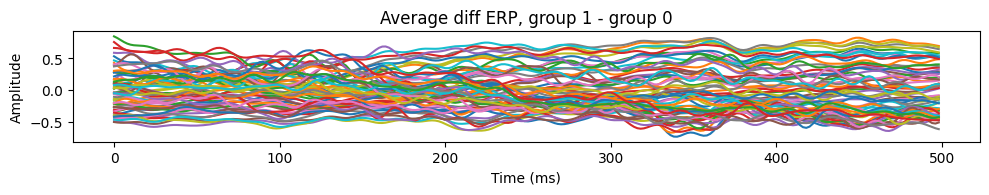

In [204]:

plt.figure(figsize=(10, 5))
plt.subplot(3, 1, 1)
plt.plot(np.arange(0,500,2),np.mean(np.array(diff[1]),axis=0)[:,0:250].T - np.mean(np.array(diff[0]),axis=0)[:,0:250].T)
plt.title(f'Average diff ERP, group 1 - group 0')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')
plt.tight_layout()
plt.show()


In [ ]:

with open('Cluster_Analysis_face_SeenVsUnseen.pkl', 'rb') as f:
    cluster_data = pickle.load(f)

In [17]:
data1 = np.array(diff[0])
data2 = np.array(diff[1])
data = np.concatenate(diff)
#print(data.shape)

In [130]:
mask = np.full(64,True)
mask[58] = False
mask[60:64] = False

In [19]:
data = all_data.data

A = all_data.groups == 0
B = all_data.groups == 1
C = all_data.stimulus == 'face'
#print(A)
#print(B)
D = A&C
E = B&C
data1 = all_data.data[:,:,D]
data2 = all_data.data[:,:,E]

data1 = data1[mask,:,:]
data2 = data2[mask,:,:]

In [27]:
A = all_data.groups == 1
#B = all_data.phase == 'invisible'
D = all_data.stimulus == 'face'
C = A*D
data[:,:,C].shape

(64, 500, 12630)

In [27]:
def channel_subselect(data, channels, boolean = False, axis = 0):

    erp_mask = np.full(data.shape[axis],boolean)
    for channel in channels:
        erp_mask[channel] = ~boolean
    return np.compress(erp_mask, data, axis=axis)

In [52]:
# Load cluster analysis data

from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from mne.viz import plot_topomap

with open('Cluster_Analysis_face_SeenVsUnseen.pkl', 'rb') as f:
    cluster_data = pickle.load(f)
T_obs = cluster_data['T_obs']
clusters = cluster_data['clusters']
cluster_p_values = cluster_data['cluster_p_values']

# Create MNE info
sfreq = 500  # Sampling frequency
montage = mne.channels.read_custom_montage('Reed_HM_59.loc')
n_channels = len(montage.ch_names)
ch_names = montage.ch_names
ch_types = ['eeg'] * n_channels
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)
info.set_montage(montage)

data1_mean = np.mean(diff[0],axis=0)
data2_mean = np.mean(diff[1],axis=0)

# Set up the figure for plotting
fig, ax = plt.subplots(1, 2, figsize=(15, 6))

cmap = plt.get_cmap('Set1')  # Choose a colormap
norm = Normalize(vmin=times.min(), vmax=times.max())  # Normalize time to [0, 1]

# Create a colormap mappable for the colorbar (optional)
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# Plot the significant clusters
times = np.arange(data1.shape[1]) / sfreq  # Convert to seconds
significant_mask = np.zeros_like(T_obs, dtype=bool)
count = 0
for i_c, c in enumerate(clusters):
    if cluster_p_values[i_c] <= 0.05:
        count = count + 1
        significant_mask[c] = True
        ax[0].axvspan(np.min(np.where(c)[0]), np.max(np.where(c)[0]), alpha=0.3,color = cmap.colors[count], label=f'Cluster {i_c}')

# Plot the ERP difference between conditions
ax[0].plot(data1_mean[14].T - data2_mean[14].T,label = 'ERP Difference')
ax[0].plot(data1_mean[14].T,label = 'ERP Data1')
ax[0].plot(data2_mean[14].T,label = 'ERP Data2')

#plt.fill_between(time_windows, min_cis[i,:,0], max_cis[i,:,1],
#    alpha=0.15, facecolor=clrs[i],label='std. error')
ax[0].set_title(f'Cluster-based Permutation Test Results')
ax[0].set_xlabel('Time (s)')
ax[0].set_ylabel('ERP Difference')
ax[0].legend(loc='lower right')
#ax[0].legend(['Significant Cluster'])

# Plot the topography of the first significant cluster
if significant_mask.any():
    mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k', linewidth=0, markersize=5)
    plot_topomap(np.mean(T_obs[:,mask],axis=0), info, show=False, axes=ax[1])
                 #mask=significant_mask.T, mask_params=mask_params)
    #plot_topomap(np.mean(T_obs[:,mask]), info, axes=ax[1], show=False, 
    #            mask=significant_mask[:,mask].T, mask_params=mask_params)
    ax[1].set_title('Topography of Significant Clusters')

# Save and show the figure
fig.savefig(f'Topography_of_Significant_Cluster.png', format='png')
plt.show()


IndexError: list index out of range

In [29]:
# with open('Cluster_Analysis_phase1Vsphase2_face _minus_noise.pkl', 'rb') as f:
#     cluster_data = pickle.load(f)

    
T_obs = cluster_data['T_obs']
clusters = cluster_data['clusters']
cluster_p_values = cluster_data['cluster_p_values']

NameError: name 'cluster_data' is not defined

In [1]:
# Load cluster analysis data

from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from mne.viz import plot_topomap



# Filter Data according to the analysis
#A = all_data.groups == 1
# B = all_data.phase == 'invisible'
# D = all_data.stimulus == 'face'
# C = A*D
# data[:,:,C].shape

# Create MNE info
sfreq = 500  # Sampling frequency
montage = mne.channels.read_custom_montage('Reed_HM_59.loc')
n_channels = len(montage.ch_names)
ch_names = montage.ch_names
ch_types = ['eeg'] * n_channels
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)
info.set_montage(montage)

# data1_mean = np.mean(data1,axis=2)

this_data1 = np.array(diff[0])
this_data2 = np.array(diff[1])

this_data1 = this_data1[:,:,250:1000]
this_data2 = this_data2[:,:,250:1000]

# this_data1 = average_reference(this_data1)
# this_data2 = average_reference(this_data2)

# this_data1 = remove_baseline(this_data1,400,500)
# this_data2 = remove_baseline(this_data2,400,500)

data1_mean = np.mean(this_data1,axis=0)
data2_mean = np.mean(this_data2,axis=0)

# Set up the figure for plotting
fig, ax = plt.subplots(2, 3, figsize=(15, 9))
ax = ax.flatten()


times = np.arange(data1.shape[1]) / sfreq  # Convert to seconds
cmap = plt.get_cmap('Set1')  # Choose a colormap
norm = Normalize(vmin=times.min(), vmax=times.max())  # Normalize time to [0, 1]

# Create a colormap mappable for the colorbar (optional)
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# Plot the ERP difference between conditions

# choose a number of channels to plot

channels_for_plotting       = [1,14,8,16,12,55]
channels_for_plotting_names = ['Cz','Pz','Fz','P3','P4','Oz']

true_data_length = this_data1.shape[2]*2

adjust_time = 250*2

clrs = ['b','g','orange']

data1_mean = channel_subselect(data1_mean, channels_for_plotting, False, axis = 0)
data2_mean = channel_subselect(data2_mean, channels_for_plotting, False, axis = 0)

std_errors1 = np.std(this_data1, axis=0) / np.sqrt(this_data1.shape[0]) 
std_errors2 = np.std(this_data1, axis=0) / np.sqrt(this_data1.shape[0]) 

# std_errors1 = np.std(data1, axis=2) / np.sqrt(data1.shape[2]) 
# std_errors2 = np.std(data2, axis=2) / np.sqrt(data2.shape[2]) 

std_errors1 = channel_subselect(std_errors1, channels_for_plotting, False, axis = 0)
std_errors2 = channel_subselect(std_errors2, channels_for_plotting, False, axis = 0)

for chan, i in enumerate(range(data1_mean.shape[0])):
    this_ax = ax[i]
    # this_ax.plot(np.arange(-adjust_time,true_data_length-adjust_time,2),data1_mean[i].T - data2_mean[i].T,label = 'ERP Difference')
    # this_ax.plot(np.arange(-adjust_time,true_data_length-adjust_time,2),data1_mean[i].T,label = 'ERP Data1')
    # up_ci = data1_mean[i] + std_errors1[i]
    # down_ci = data1_mean[i] - std_errors1[i]
    # this_ax.fill_between(np.arange(-adjust_time,true_data_length-adjust_time,2),up_ci.T, down_ci.T,alpha=0.5)
    # this_ax.plot(np.arange(-adjust_time,true_data_length-adjust_time,2),data2_mean[i].T,label = 'ERP Data2')
    # up_ci = data2_mean[i] + std_errors2[i]
    # down_ci = data2_mean[i] - std_errors2[i]
    # this_ax.fill_between(np.arange(-adjust_time,true_data_length-adjust_time,2),up_ci.T, down_ci.T,alpha=0.5)

    this_ax.plot(np.arange(-adjust_time,true_data_length-adjust_time,2),data1_mean[i].T - data2_mean[i].T,label = 'ERP Difference')
    this_ax.plot(np.arange(-adjust_time,true_data_length-adjust_time,2),data1_mean[i].T,label = 'ERP Data1')
    up_ci = data1_mean[i] + std_errors1[i]
    down_ci = data1_mean[i] - std_errors1[i]
    this_ax.fill_between(np.arange(-adjust_time,true_data_length-adjust_time,2),up_ci.T, down_ci.T,alpha=0.5)
    this_ax.plot(np.arange(-adjust_time,true_data_length-adjust_time,2),data2_mean[i].T,label = 'ERP Data2')
    up_ci = data2_mean[i] + std_errors2[i]
    down_ci = data2_mean[i] - std_errors2[i]
    this_ax.fill_between(np.arange(-adjust_time,true_data_length-adjust_time,2),up_ci.T, down_ci.T,alpha=0.5)

#plt.fill_between(time_windows, min_cis[i,:,0], max_cis[i,:,1],
#    alpha=0.15, facecolor=clrs[i],label='std. error')
    this_ax.set_title(f'ERP difference at Channel {channels_for_plotting_names[i]}')
    this_ax.set_xlabel('Time (ms)')
    this_ax.set_ylabel('ERP Difference')
    this_ax.legend(loc='best')

fig.savefig(f'Channel ERPs.png', format='png')
plt.show()


NameError: name 'mne' is not defined

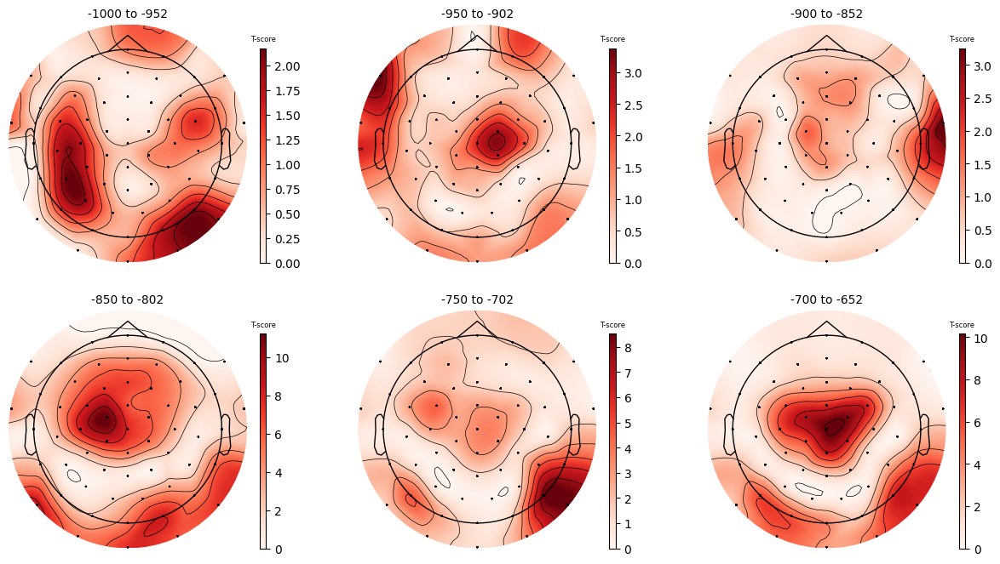

In [36]:

# Plot the significant clusters
significant_mask = np.zeros_like(T_obs, dtype=bool)
count = 0
for i_c, c in enumerate(clusters):
    if cluster_p_values[i_c] <= 0.05:
        count = count + 1
        significant_mask[c] = True
        #ax[0,0].axvspan(np.min(np.where(c)[0]), np.max(np.where(c)[0]), alpha=0.3,color = cmap.colors[count], label=f'Cluster {i_c}')

# Plot the topography of the first significant cluster
plot_times = [np.arange(0,25),np.arange(25,50),np.arange(50,75),np.arange(75,100),np.arange(125,150),np.arange(150,175)]
 


fig, ax = plt.subplots(2, int(len(plot_times)/2), figsize=(15, 8))
ax = ax.flatten()

if significant_mask.any():
    for j, time_erp in enumerate(plot_times):
        this_ax = ax[j]
        this_T_obs = T_obs[:,:].T
        this_mask = significant_mask[: ,:].T
        mask_params = dict(marker='o', markerfacecolor='r', markeredgecolor='k', linewidth=0, markersize=5)
        topomap_data = np.mean(np.take(this_T_obs,time_erp,axis=0),axis=0)
        im,cm = plot_topomap(topomap_data, info, show=False, axes=this_ax, mask=np.take(this_mask,time_erp,axis=0).T, mask_params=mask_params)
        
        pos = this_ax.get_position()
        time1 = (time_erp[0]-500) * 2
        time2 = (np.max(time_erp)-500) * 2
        this_ax.set_title(f'{time1} to {time2}',fontsize = 10)
        cbar_ax = fig.add_axes([pos.x1 + 0.01, pos.y0, 0.005, pos.height*0.9])  # Adjusted relative to topomap
        clb = plt.colorbar(im, cax=cbar_ax)
        clb.ax.set_title(f'T-score',fontsize=6) # title on top of colorbar
else:
    print('no significant effects found')

# Save and show the figure
fig.savefig(f'Topography_of_Significant_Cluster.png', format='png')
plt.show()